<a href="https://colab.research.google.com/github/Chenyuju/chen/blob/master/Food_Recommendation_System_(KNHANES).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
!pip install pyspark

     |████████████████████████████████| 204.2MB 66kB/s 
     |████████████████████████████████| 204kB 24.7MB/s 
  Created wheel for pyspark: filename=pyspark-3.0.1-py2.py3-none-any.whl size=204612243 sha256=ba113490aed2c407d22d8ba09f5834d2cefcaba5c281527670ffef0382a47d92
  Stored in directory: /root/.cache/pip/wheels/5e/bd/07/031766ca628adec8435bb40f0bd83bb676ce65ff4007f8e73f
Successfully built pyspark


In [ ]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.master("local[*]").getOrCreate()
sc = spark.sparkContext

In [ ]:
hn16_all = spark.read.format('com.databricks.spark.csv').options(header='true', inferschema='true').load("/content/chen/KNHANES/hn16_base.csv",header=True);

hn16_all.show()

In [ ]:
hn16_all.columns

In [ ]:
from pyspark.sql.functions import isnan, isnull, when, count, col

hn16_all.select([count(when(isnull(c), c)).alias(c) for c in hn16_all.columns]).show()

In [5]:
data = pd.read_csv('/content/chen/KNHANES/hn16_base.csv')
data

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (204,211,215,289,290,296,328,333,341,362,439,451,457,492,582,639,674) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,mod_d,ID,ID_fam,year,region,town_t,apt_t,psu,sex,age,...,FQ_FE,FQ_NA,FQ_K,FQ_VA,FQ_RETIN,FQ_CAROT,FQ_B1,FQ_B2,FQ_NIAC,FQ_VITC
0,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
1,2020.01.15.,A651172802,A6511728,2016,1,1,2,A651,2,57,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
2,2020.01.15.,A651183001,A6511830,2016,1,1,2,A651,2,41,...,12.879218,3671.647791,2226.426572,459.311661,84.990392,2158.129699,1.628015,1.133830,13.896055,79.1503547967535
3,2020.01.15.,A651183002,A6511830,2016,1,1,2,A651,1,39,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
4,2020.01.15.,A651183003,A6511830,2016,1,1,2,A651,2,38,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8145,2020.01.15.,R654353001,R6543530,2016,8,2,2,R654,1,75,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
8146,2020.01.15.,R654353002,R6543530,2016,8,2,2,R654,2,72,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,
8147,2020.01.15.,R654370001,R6543700,2016,8,2,2,R654,2,54,...,13.772217,3758.749525,2733.672026,747.888439,113.601673,3765.786356,1.661161,1.549361,10.874105,113.431764579543
8148,2020.01.15.,R654370002,R6543700,2016,8,2,2,R654,1,56,...,9.774473,1734.416866,1841.486369,378.456512,43.232393,1915.498701,1.252735,0.839292,7.499069,58.0867583528837


In [6]:
percentage=(data.isnull().mean())*100
pd.set_option("max_rows", None)
percentage.sort_values(ascending=False)

AC8_1e_04        100.000000
DE1_35           100.000000
AC3_3e_04        100.000000
AC8_1e_02        100.000000
AC8_1e_03        100.000000
BS12_22          100.000000
AC8_2w_04         99.987730
AC8_1_04          99.987730
AC3_2_04          99.987730
AC8_3_04          99.987730
h_school_t_1      99.987730
AC8_2_04          99.987730
AC3_4_04          99.987730
AC3_3_04          99.987730
AC3_1_04          99.987730
AC3_3e_03         99.987730
BS12_45           99.987730
HE_Folate_etc     99.987730
AC8_3w_04         99.987730
AC8_1e_01         99.987730
BM13_6            99.975460
BH9_14_4_02       99.963190
FS_MEAL_O         99.950920
BS12_35           99.950920
AC8_1_03          99.938650
AC8_2_03          99.938650
BO3_11            99.938650
AC3_3e_02         99.938650
EC_wht_6          99.938650
AC3_3_03          99.938650
AC8_2w_03         99.938650
AC8_3_03          99.938650
AC8_3w_03         99.938650
AC3_4_03          99.938650
AC3_1_03          99.938650
AC3_2_03          99

In [7]:
df=data.dropna(thresh=2445, axis=1)
print(f"Data shape before cleaning {data.shape}")
print(f"Data shape after cleaning {df.shape}")
print(f"We dropped {data.shape[1]- df.shape[1]} columns")

Data shape before cleaning (8150, 1188)
Data shape after cleaning (8150, 1053)
We dropped 135 columns


In [8]:
percentage=(df.isnull().mean())*100
pd.set_option("max_rows", None)
percentage.sort_values(ascending=False)

wt_nnnt         67.754601
wt_hmnt         67.177914
wt_pfnt         65.656442
wt_nn           62.564417
HE_NNAL         62.552147
HE_Pb           61.055215
HE_Cd           61.055215
HE_Hg           61.055215
wt_hm           61.055215
HE_Folate       60.478528
HE_VitE         60.466258
HE_VitA         60.466258
wt_pft          60.000000
FQ_MUFA         58.650307
FQ_EN           58.650307
FQ_PROT         58.650307
FQ_FAT          58.650307
FQ_SFA          58.650307
FQ_NIAC         58.650307
FQ_PUFA         58.650307
FQ_NA           58.650307
FQ_B2           58.650307
FQ_N3           58.650307
FQ_B1           58.650307
FQ_RETIN        58.650307
FQ_VA           58.650307
FQ_K            58.650307
FQ_CAROT        58.650307
FQ_FE           58.650307
FQ_CA           58.650307
FQ_TDF          58.650307
FQ_CHO          58.650307
FQ_N6           58.650307
FQ_PHOS         58.650307
FQ_CHOL         58.650307
FQ_J_BUDA       58.638037
FQ_F_EGG        58.638037
FQ_S_BEAN       58.638037
FQ_BNCURD   

In [9]:
r, c = df.shape
r, c

(8150, 1053)

In [10]:
# --- 나이와 성별에 대한 14 가지의 표준영양소값 구하기 ---

In [11]:
def standard_EN(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 1000
    elif ((age >= 3) & (age < 6)):
        return 1400
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 1700
        elif ((age >= 9) & (age < 12)):
            return 2100
        elif ((age >= 12) & (age < 15)):
            return 2500
        elif ((age >= 15) & (age < 19)):
            return 2700
        elif ((age >= 19) & (age < 30)):
            return 2600
        elif ((age >= 30) & (age < 40)):
            return 2400
        elif ((age >= 40) & (age < 65)):
            return 2200
        elif ((age >= 65) & (age < 75)):
            return 2000
        elif (age >= 75):
            return 2000
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 1500
        elif ((age >= 9) & (age < 12)):
            return 1800
        elif ((age >= 12) & (age < 15)):
            return 2000
        elif ((age >= 15) & (age < 19)):
            return 2100
        elif ((age >= 19) & (age < 30)):
            return 1900
        elif ((age >= 30) & (age < 40)):
            return 1800
        elif ((age >= 40) & (age < 65)):
            return 1600
        elif ((age >= 65) & (age < 75)):
            return 2000
        elif (age >= 75):
            return 1600
    else:
      return 0

In [12]:
df['SN_EN'] = df.apply(standard_EN, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [13]:
def standard_PROT(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 15
    elif ((age >= 3) & (age < 6)):
        return 20
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 30
        elif ((age >= 9) & (age < 12)):
            return 40
        elif ((age >= 12) & (age < 15)):
            return 55
        elif ((age >= 15) & (age < 19)):
            return 65
        elif ((age >= 19) & (age < 30)):
            return 65
        elif ((age >= 30) & (age < 40)):
            return 60
        elif ((age >= 40) & (age < 65)):
            return 60
        elif ((age >= 65) & (age < 75)):
            return 55
        elif (age >= 75):
            return 55
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 25
        elif ((age >= 9) & (age < 12)):
            return 40
        elif ((age >= 12) & (age < 15)):
            return 50
        elif ((age >= 15) & (age < 19)):
            return 50
        elif ((age >= 19) & (age < 30)):
            return 55
        elif ((age >= 30) & (age < 40)):
            return 50
        elif ((age >= 40) & (age < 65)):
            return 50
        elif ((age >= 65) & (age < 75)):
            return 45
        elif (age >= 75):
            return 45
    else:
      return 0

In [14]:
df['SN_PROT'] = df.apply(standard_PROT, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [15]:
def standard_TDF(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 10
    elif ((age >= 3) & (age < 6)):
        return 15
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 20
        elif ((age >= 9) & (age < 12)):
            return 20
        elif ((age >= 12) & (age < 75)):
            return 25
        elif (age >= 75):
            return 55
    elif (sex == 2):
        if ((age >= 6) & (age < 75)):
            return 20
        elif (age >= 75):
            return 20
    else:
      return 0

In [16]:
df['SN_TDF'] = df.apply(standard_TDF, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [17]:
def standard_WATER(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 1100
    elif ((age >= 3) & (age < 6)):
        return 1500
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 1800
        elif ((age >= 9) & (age < 12)):
            return 2100
        elif ((age >= 12) & (age < 15)):
            return 2300
        elif ((age >= 15) & (age < 19)):
            return 2600
        elif ((age >= 19) & (age < 30)):
            return 2600
        elif ((age >= 30) & (age < 40)):
            return 2500
        elif ((age >= 40) & (age < 65)):
            return 2200
        elif ((age >= 65) & (age < 75)):
            return 2100
        elif (age >= 75):
            return 2100
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 1700
        elif ((age >= 9) & (age < 12)):
            return 1900
        elif ((age >= 12) & (age < 19)):
            return 2000
        elif ((age >= 19) & (age < 30)):
            return 2100
        elif ((age >= 30) & (age < 40)):
            return 2000
        elif ((age >= 40) & (age < 65)):
            return 1900
        elif ((age >= 65) & (age < 75)):
            return 1800
        elif (age >= 75):
            return 1800
    else:
      return 0

In [18]:
df['SN_WATER'] = df.apply(standard_WATER, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [19]:
def standard_VITC(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 35
    elif ((age >= 3) & (age < 6)):
        return 40
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 55
        elif ((age >= 9) & (age < 12)):
            return 70
        elif ((age >= 12) & (age < 15)):
            return 90
        elif ((age >= 15) & (age < 19)):
            return 105
        elif ((age >= 19) & (age < 75)):
            return 100
        elif (age >= 75):
            return 100
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 60
        elif ((age >= 9) & (age < 12)):
            return 80
        elif ((age >= 12) & (age < 19)):
            return 100
        elif ((age >= 19) & (age < 30)):
            return 95
        elif ((age >= 30) & (age < 75)):
            return 100
        elif (age >= 75):
            return 100
    else:
      return 0

In [20]:
df['SN_VITC'] = df.apply(standard_VITC, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [21]:
def standard_B1(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 0.5
    elif ((age >= 3) & (age < 6)):
        return 0.5
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 0.7
        elif ((age >= 9) & (age < 12)):
            return 0.9
        elif ((age >= 12) & (age < 15)):
            return 1.1
        elif ((age >= 15) & (age < 19)):
            return 1.3
        elif ((age >= 19) & (age < 75)):
            return 1.2
        elif (age >= 75):
            return 1.2
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 0.7
        elif ((age >= 9) & (age < 12)):
            return 0.9
        elif ((age >= 12) & (age < 14)):
            return 1.1
        elif ((age >= 15) & (age < 18)):
            return 1.2
        elif ((age >= 19) & (age < 75)):
            return 1.1
        elif (age >= 75):
            return 1.1
    else:
      return 0

In [22]:
df['SN_B1'] = df.apply(standard_B1, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [23]:
def standard_B2(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 0.5
    elif ((age >= 3) & (age < 6)):
        return 0.6
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 0.9
        elif ((age >= 9) & (age < 12)):
            return 1.2
        elif ((age >= 12) & (age < 14)):
            return 1.5
        elif ((age >= 15) & (age < 18)):
            return 1.7
        elif ((age >= 19) & (age < 75)):
            return 1.5
        elif (age >= 75):
            return 1.5
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 0.8
        elif ((age >= 9) & (age < 12)):
            return 1.0
        elif ((age >= 12) & (age < 75)):
            return 1.2
        elif (age >= 75):
            return 1.2
    else:
      return 0

In [24]:
df['SN_B2'] = df.apply(standard_B2, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [25]:
def standard_NIAC(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 6
    elif ((age >= 3) & (age < 6)):
        return 7
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 9
        elif ((age >= 9) & (age < 12)):
            return 12
        elif ((age >= 12) & (age < 15)):
            return 15
        elif ((age >= 15) & (age < 19)):
            return 17
        elif ((age >= 19) & (age < 75)):
            return 16
        elif (age >= 75):
            return 16
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 9
        elif ((age >= 9) & (age < 12)):
            return 12
        elif ((age >= 12) & (age < 15)):
            return 15
        elif ((age >= 15) & (age < 75)):
            return 14
        elif (age >= 75):
            return 14
    else:
      return 0

In [26]:
df['SN_NIAC'] = df.apply(standard_NIAC, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [27]:
def standard_VA_RAE(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 300
    elif ((age >= 3) & (age < 6)):
        return 350
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 450
        elif ((age >= 9) & (age < 12)):
            return 600
        elif ((age >= 12) & (age < 15)):
            return 750
        elif ((age >= 15) & (age < 19)):
            return 850
        elif ((age >= 19) & (age < 30)):
            return 800
        elif ((age >= 30) & (age < 65)):
            return 750
        elif ((age >= 65) & (age < 75)):
            return 700
        elif (age >= 75):
            return 700
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 400
        elif ((age >= 9) & (age < 12)):
            return 550
        elif ((age >= 12) & (age < 15)):
            return 650
        elif ((age >= 15) & (age < 19)):
            return 600
        elif ((age >= 19) & (age < 50)):
            return 650
        elif ((age >= 50) & (age < 65)):
            return 600
        elif ((age >= 65) & (age < 75)):
            return 550
        elif (age >= 75):
            return 550
    else:
      return 0

In [28]:
df['SN_VA_RAE'] = df.apply(standard_VA_RAE, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [29]:
def standard_CA(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 500
    elif ((age >= 3) & (age < 6)):
        return 600
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 700
        elif ((age >= 9) & (age < 12)):
            return 800
        elif ((age >= 12) & (age < 15)):
            return 1000
        elif ((age >= 15) & (age < 19)):
            return 900
        elif ((age >= 19) & (age < 50)):
            return 800
        elif ((age >= 50) & (age < 65)):
            return 750
        elif ((age >= 65) & (age < 75)):
            return 700
        elif (age >= 75):
            return 700
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 700
        elif ((age >= 9) & (age < 12)):
            return 800
        elif ((age >= 12) & (age < 15)):
            return 900
        elif ((age >= 15) & (age < 19)):
            return 800
        elif ((age >= 19) & (age < 50)):
            return 700
        elif ((age >= 50) & (age < 75)):
            return 800
        elif (age >= 75):
            return 800
    else:
      return 0

In [30]:
df['SN_CA'] = df.apply(standard_CA, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [31]:
def standard_PHOS(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 450
    elif ((age >= 3) & (age < 6)):
        return 550
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 600
        elif ((age >= 9) & (age < 19)):
            return 1200
        elif ((age >= 19) & (age < 75)):
            return 700
        elif (age >= 75):
            return 700
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 550
        elif ((age >= 9) & (age < 19)):
            return 1200
        elif ((age >= 12) & (age < 75)):
            return 700
        elif (age >= 75):
            return 700
    else:
      return 0

In [32]:
df['SN_PHOS'] = df.apply(standard_PHOS, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [33]:
def standard_NA(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 0.9
    elif ((age >= 3) & (age < 6)):
        return 1.0
    elif ((age >= 6) & (age < 9)):
        return 1.2
    elif ((age >= 9) & (age < 12)):
        return 1.4
    elif ((age >= 12) & (age < 65)):
        return 1.5
    elif ((age >= 65) & (age < 75)):
        return 1.3
    elif (age >= 75):
        return 1.1
    else:
      return 0

In [34]:
df['SN_NA'] = df.apply(standard_NA, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [35]:
def standard_K(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 3)):
        return 2.0
    elif ((age >= 3) & (age < 6)):
        return 2.3
    elif ((age >= 6) & (age < 9)):
        return 2.6
    elif ((age >= 9) & (age < 12)):
        return 3.0
    elif ((age >= 12) & (age < 75)):
        return 3.5
    elif (age >= 75):
        return 3.5
    else:
      return 0

In [36]:
df['SN_K'] = df.apply(standard_K, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [37]:
def standard_FE(series):
    age = series["age"]
    sex = series["sex"]

    if ((age >= 1) & (age < 6)):
        return 6
    elif (sex == 1):
        if ((age >= 6) & (age < 9)):
            return 9
        elif ((age >= 9) & (age < 12)):
            return 10
        elif ((age >= 12) & (age < 19)):
            return 14
        elif ((age >= 19) & (age < 65)):
            return 10
        elif ((age >= 65) & (age < 75)):
            return 9
        elif (age >= 75):
            return 9
    elif (sex == 2):
        if ((age >= 6) & (age < 9)):
            return 8
        elif ((age >= 9) & (age < 12)):
            return 10
        elif ((age >= 12) & (age < 15)):
            return 16
        elif ((age >= 15) & (age < 50)):
            return 14
        elif ((age >= 50) & (age < 75)):
            return 8
        elif (age >= 75):
            return 7
    else:
      return 0

In [38]:
df['SN_FE'] = df.apply(standard_FE, axis=1)

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [39]:
print(df[['age', 'sex', 'N_EN', 'SN_EN', 'N_PROT', 'SN_PROT', 'N_TDF', 'SN_TDF', 'N_WATER', 'SN_WATER', 'N_VITC', 'SN_VITC', 'N_B1', 'SN_B1', 'N_B2', 'SN_B2', 'N_NIAC', 'SN_NIAC', 'N_VA_RAE', 'SN_VA_RAE', 'N_CA', 'SN_CA', 'N_PHOS', 'SN_PHOS', 'N_NA', 'SN_NA', 'N_K', 'SN_K', 'N_FE', 'SN_FE']])

      age  sex         N_EN  SN_EN      N_PROT  SN_PROT       N_TDF  SN_TDF  \
0      61    1  2645.710622   2200   71.269316       60   52.224652      25   
1      57    2   700.952504   1600   18.016716       50   10.723772      20   
2      41    2  1376.501787   1600   49.303023       50   24.142831      20   
3      39    1          NaN   2400         NaN       60         NaN      25   
4      38    2          NaN   1800         NaN       50         NaN      20   
5       3    2          NaN   1400         NaN       20         NaN      15   
6       5    2          NaN   1400         NaN       20         NaN      15   
7      44    2  1679.984287   1600   61.734465       50   17.891656      20   
8      38    1  3202.536935   2400  153.979665       60   12.302415      25   
9      35    2  2532.117780   1800  109.851635       50   19.092901      20   
10      3    1   754.050427   1400   21.848866       20    6.084643      15   
11      1    2   416.811652   1000    9.816229      

In [40]:
# --- 표준영양소값과 개인별 영양소값의 차이를 구하기 ---

In [41]:
df['Diff_EN'] = np.where(df['N_EN'] == df['SN_EN'], 0, df['N_EN']-df['SN_EN'])
df['Diff_PROT'] = np.where(df['N_PROT'] == df['SN_PROT'], 0, df['N_PROT']-df['SN_PROT'])
df['Diff_TDF'] = np.where(df['N_TDF'] == df['SN_TDF'], 0, df['N_TDF']-df['SN_TDF'])
df['Diff_WATER'] = np.where(df['N_WATER'] == df['SN_WATER'], 0, df['N_WATER']-df['SN_WATER'])
df['Diff_VITC'] = np.where(df['N_VITC'] == df['SN_VITC'], 0, df['N_VITC']-df['SN_VITC'])
df['Diff_B1'] = np.where(df['N_B1'] == df['SN_B1'], 0, df['N_B1']-df['SN_B1'])
df['Diff_B2'] = np.where(df['N_B2'] == df['SN_B2'], 0, df['N_B2']-df['SN_B2'])
df['Diff_NIAC'] = np.where(df['N_NIAC'] == df['SN_NIAC'], 0, df['N_NIAC']-df['SN_NIAC'])
df['Diff_VA_RAE'] = np.where(df['N_VA_RAE'] == df['SN_VA_RAE'], 0, df['N_VA_RAE']-df['SN_VA_RAE'])
df['Diff_CA'] = np.where(df['N_CA'] == df['SN_CA'], 0, df['N_CA']-df['SN_CA'])
df['Diff_PHOS'] = np.where(df['N_PHOS'] == df['SN_PHOS'], 0, df['N_PHOS']-df['SN_PHOS'])
df['Diff_NA'] = np.where(df['N_NA'] == df['SN_NA'], 0, df['N_NA']-df['SN_NA'])
df['Diff_K'] = np.where(df['N_K'] == df['SN_K'], 0, df['N_K']-df['SN_K'])
df['Diff_FE'] = np.where(df['N_FE'] == df['SN_FE'], 0, df['N_FE']-df['SN_FE'])

print(df[['N_EN', 'SN_EN', 'Diff_EN', 'N_PROT', 'SN_PROT', 'Diff_PROT', 'N_TDF', 'SN_TDF', 'Diff_TDF', 
          'N_WATER', 'SN_WATER', 'Diff_WATER', 'N_VITC', 'SN_VITC', 'Diff_VITC', 'N_B1', 'SN_B1', 'Diff_B1',
          'N_B2', 'SN_B2', 'Diff_B2', 'N_NIAC', 'SN_NIAC', 'Diff_NIAC', 'N_VA_RAE', 'SN_VA_RAE', 'Diff_VA_RAE',
          'N_CA', 'SN_CA', 'Diff_CA', 'N_PHOS', 'SN_PHOS', 'Diff_PHOS', 'N_NA', 'SN_NA', 'Diff_NA',
          'N_K', 'SN_K', 'Diff_K', 'N_FE', 'SN_FE', 'Diff_FE']])

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc

             N_EN  SN_EN      Diff_EN      N_PROT  SN_PROT   Diff_PROT  \
0     2645.710622   2200   445.710622   71.269316       60   11.269316   
1      700.952504   1600  -899.047496   18.016716       50  -31.983284   
2     1376.501787   1600  -223.498213   49.303023       50   -0.696977   
3             NaN   2400          NaN         NaN       60         NaN   
4             NaN   1800          NaN         NaN       50         NaN   
5             NaN   1400          NaN         NaN       20         NaN   
6             NaN   1400          NaN         NaN       20         NaN   
7     1679.984287   1600    79.984287   61.734465       50   11.734465   
8     3202.536935   2400   802.536935  153.979665       60   93.979665   
9     2532.117780   1800   732.117780  109.851635       50   59.851635   
10     754.050427   1400  -645.949573   21.848866       20    1.848866   
11     416.811652   1000  -583.188348    9.816229       15   -5.183771   
12            NaN   1600          NaN 

In [42]:
pd.set_option("max_columns", None)
print(df[['Diff_EN', 'Diff_PROT', 'Diff_TDF', 'Diff_WATER', 'Diff_VITC', 
          'Diff_B1', 'Diff_B2','Diff_NIAC', 'Diff_VA_RAE', 'Diff_CA', 
          'Diff_PHOS', 'Diff_NA', 'Diff_K', 'Diff_FE']])

          Diff_EN   Diff_PROT    Diff_TDF   Diff_WATER    Diff_VITC  \
0      445.710622   11.269316   27.224652  -383.163326   -13.352423   
1     -899.047496  -31.983284   -9.276228 -1421.705945   -61.127303   
2     -223.498213   -0.696977    4.142831  -603.291268   -64.738218   
3             NaN         NaN         NaN          NaN          NaN   
4             NaN         NaN         NaN          NaN          NaN   
5             NaN         NaN         NaN          NaN          NaN   
6             NaN         NaN         NaN          NaN          NaN   
7       79.984287   11.734465   -2.108344 -1200.874951    15.081320   
8      802.536935   93.979665  -12.697585 -1700.301499   -76.512794   
9      732.117780   59.851635   -0.907099  -748.476117   -47.575512   
10    -645.949573    1.848866   -8.915357 -1131.785300    18.247595   
11    -583.188348   -5.183771   -6.672324  -882.111759    -1.609646   
12            NaN         NaN         NaN          NaN          NaN   
13    

In [43]:
# --- 식단 작성하기 (1단계 - 표준체중 구하기) [성인]

In [44]:
df_drop = df[df['age'] < 19].index
df = df.drop(df_drop)

In [45]:
r, c = df.shape
r, c

(6382, 1081)

In [46]:
print(df[['ID', 'sex', 'age']])

              ID  sex  age
0     A651172801    1   61
1     A651172802    2   57
2     A651183001    2   41
3     A651183002    1   39
4     A651183003    2   38
7     A651194902    2   44
8     A651205101    1   38
9     A651205102    2   35
12    A651228902    2   78
13    A651235701    1   61
14    A651249301    1   49
15    A651249302    2   44
17    A651261202    2   51
18    A651268001    1   49
19    A651268002    2   45
22    A651281601    1   42
23    A651293501    2   62
24    A651293502    2   36
25    A651293503    1   32
26    A651302001    2   36
27    A651302002    1   41
30    A651319001    1   47
31    A651319002    2   40
32    A651324101    1   46
33    A651324102    2   46
36    A651354702    2   38
38    A651359801    1   43
39    A651359802    2   43
41    A651373401    2   40
43    A651373404    1   43
44    A651381901    1   52
45    A651381902    2   51
46    A651381903    2   24
48    A651397201    1   54
49    A651397202    2   53
50    A651397203    1   21
5

In [47]:
def standard_WEIGHT(series):
  sex = series["sex"]
  height = series["HE_ht"]
  
  if sex == 1:
    return ((height/100) * (height/100) * 22)
  elif sex == 2:
    return ((height/100) * (height/100) * 21)
  else:
    return 0

In [48]:
df['S_WEIGHT'] = df.apply(standard_WEIGHT, axis=1)

In [49]:
print(df[['age', 'HE_ht', 'sex', 'S_WEIGHT']])

      age  HE_ht  sex   S_WEIGHT
0      61  167.2    1  61.502848
1      57  156.6    2  51.499476
2      41  157.8    2  52.291764
3      39  176.7    1  68.690358
4      38  159.5    2  53.424525
7      44  156.4    2  51.368016
8      38  166.4    1  60.915712
9      35  162.2    2  55.248564
12     78  150.1    2  47.313021
13     61  171.6    1  64.782432
14     49  180.0    1  71.280000
15     44  161.7    2  54.908469
17     51  157.9    2  52.358061
18     49  169.1    1  62.908582
19     45  154.4    2  50.062656
22     42  178.3    1  69.939958
23     62  158.3    2  52.623669
24     36  165.8    2  57.728244
25     32  176.6    1  68.612632
26     36  163.3    2  56.000469
27     41  173.1    1  65.919942
30     47  175.9    1  68.069782
31     40  158.7    2  52.889949
32     46  180.4    1  71.597152
33     46  166.7    2  58.356669
36     38  158.4    2  52.690176
38     43  167.3    1  61.576438
39     43  164.5    2  56.826525
41     40  160.0    2  53.760000
43     43 

In [50]:
# --- 식단 작성하기 (2단계 - 비만도 구하기) [성인]

In [51]:
def BMI(series):
  height = series["HE_ht"]
  weight = series["HE_wt"]
  bmi = (weight/((height/100) * (height/100)))

  if (bmi < 18.5):
    return 1
  elif ((bmi >= 18.5) & (bmi < 25)):
    return 2
  elif (bmi >= 25):
    return 3
  else:
    return 0

In [52]:
df['BMI'] = df.apply(BMI, axis=1)

In [53]:
print(df[['age', 'sex', 'HE_ht', 'HE_wt', 'HE_BMI', 'BMI']])

      age  sex  HE_ht  HE_wt     HE_BMI  BMI
0      61    1  167.2   68.7  24.574472    2
1      57    2  156.6   52.0  21.204099    2
2      41    2  157.8   58.8  23.613661    2
3      39    1  176.7   93.4  29.913951    3
4      38    2  159.5   54.1  21.265514    2
7      44    2  156.4   52.0  21.258364    2
8      38    1  166.4   74.1  26.761569    3
9      35    2  162.2   61.2  23.262143    2
12     78    2  150.1   52.7  23.391024    2
13     61    1  171.6   78.4  26.624502    3
14     49    1  180.0   85.1  26.265432    3
15     44    2  161.7   48.5  18.549051    2
17     51    2  157.9   52.5  21.056930    2
18     49    1  169.1   81.3  28.431733    3
19     45    2  154.4   62.1  26.049357    3
22     42    1  178.3   87.0  27.366330    3
23     62    2  158.3   54.4  21.708863    2
24     36    2  165.8   75.2  27.355760    3
25     32    1  176.6   88.8  28.472891    3
26     36    2  163.3   65.1  24.412296    2
27     41    1  173.1   68.3  22.794316    2
30     47 

In [54]:
# --- 식단 작성하기 (3단계 - 체중 1kg당 필요한 열량 구하기) [성인]

In [55]:
def calculate_activity(series):
      work_high_day = series["BE3_72"] 
      work_high_hour = series["BE3_73"]
      work_high_min = series["BE3_74"]

      work_moderate_day = series["BE3_82"]
      work_moderate_hour = series["BE3_83"]
      work_moderate_min = series["BE3_84"]

      #transporation_day = series["BE3_92"]
      #transporation_hour = series["BE3_93"]
      #transporation_min = series["BE3_94"]

      leisure_high_day = series["BE3_76"]
      leisure_high_hour = series["BE3_77"]
      leisure_high_min = series["BE3_78"]

      leisure_moderate_day = series["BE3_86"]
      leisure_moderate_hour = series["BE3_87"]
      leisure_moderate_min = series["BE3_88"]

      walk_day = series["BE3_31"]
      walk_hour = series["BE3_32"]
      walk_min = series["BE3_33"]

      if ((work_high_day < 8) | (work_moderate_day < 8) | (leisure_high_day < 8) |
          (leisure_moderate_day < 8) | (walk_day < 9)):
        work_high_total_min = (work_high_hour*60 + work_high_min)
        work_moderate_total_min = (work_moderate_hour*60 + work_moderate_min)
        #transporation_total_min = (transporation_hour*60 + transporation_min)
        leisure_high_total_min = (leisure_high_hour*60 + leisure_high_min)
        leisure_moderate_total_min = (leisure_moderate_hour*60 + leisure_moderate_min)
        walk_total_min = (walk_hour*60 + walk_min)

        met_total_walk_min = (walk_total_min*walk_day*3.3)
        met_total_vigorous_min = ((work_high_total_min*work_high_day*8) + (leisure_high_total_min*leisure_high_day*8))
        met_total_moderate_min = ((work_moderate_total_min*work_moderate_day*4) + (leisure_moderate_total_min*leisure_moderate_day*4))
       
        if (((((work_high_day >=3) & (work_high_day < 8)) & ((leisure_high_day >= 3) & (leisure_high_day < 8))) & (met_total_vigorous_min >= 1500)) | ((walk_day == 8) & (met_total_walk_min >= 3000))):
            return 3
        elif ((((work_moderate_day >= 5) & (work_moderate_day < 8)) & (work_moderate_total_min >= 30)) | (((leisure_moderate_day >= 5) & (leisure_moderate_day < 8)) & (leisure_moderate_total_min >= 30)) | (((work_high_day >=3) & (work_high_day < 8)) & (work_high_total_min >= 20)) | (((leisure_moderate_day >= 5) & (leisure_moderate_day < 8)) & (leisure_high_total_min >= 20)) | (((walk_day >= 6) & (walk_day < 9)) & (met_total_walk_min >= 600))):
            return 2
        else:
            return 1
      else:
        return 0

In [56]:
df['activity'] = df.apply(calculate_activity, axis=1)

In [57]:
print(df[['ID', 'age', 'activity']])

              ID  age  activity
0     A651172801   61         2
1     A651172802   57         1
2     A651183001   41         2
3     A651183002   39         1
4     A651183003   38         2
7     A651194902   44         2
8     A651205101   38         1
9     A651205102   35         3
12    A651228902   78         1
13    A651235701   61         2
14    A651249301   49         2
15    A651249302   44         1
17    A651261202   51         1
18    A651268001   49         1
19    A651268002   45         1
22    A651281601   42         1
23    A651293501   62         3
24    A651293502   36         2
25    A651293503   32         2
26    A651302001   36         1
27    A651302002   41         1
30    A651319001   47         2
31    A651319002   40         1
32    A651324101   46         1
33    A651324102   46         2
36    A651354702   38         1
38    A651359801   43         2
39    A651359802   43         2
41    A651373401   40         1
43    A651373404   43         1
44    A6

In [58]:
def recommend_EN(series):
    activity = series["activity"]
    bmi = series["BMI"]
    weight = series["HE_wt"]

    if (activity == 1):
      if (bmi == 1):
        return (35*weight)
      elif (bmi == 2):
        return (30*weight)
      elif (bmi == 3):
        return (25*weight)
    elif (activity == 2):
      if (bmi == 1):
        return (40*weight)
      elif (bmi == 2):
        return (35*weight)
      elif (bmi == 3):
        return (30*weight)
    elif (activity == 3):
      if (bmi == 1):
        return (45*weight)
      elif (bmi == 2):
        return (40*weight)
      elif (bmi == 3):
        return (35*weight)
    else:
      return 0


In [59]:
df['recom_EN'] = df.apply(recommend_EN, axis=1)

In [60]:
print(df[['ID', 'age', 'HE_wt', 'BMI', 'activity', 'recom_EN']])

              ID  age  HE_wt  BMI  activity  recom_EN
0     A651172801   61   68.7    2         2    2404.5
1     A651172802   57   52.0    2         1    1560.0
2     A651183001   41   58.8    2         2    2058.0
3     A651183002   39   93.4    3         1    2335.0
4     A651183003   38   54.1    2         2    1893.5
7     A651194902   44   52.0    2         2    1820.0
8     A651205101   38   74.1    3         1    1852.5
9     A651205102   35   61.2    2         3    2448.0
12    A651228902   78   52.7    2         1    1581.0
13    A651235701   61   78.4    3         2    2352.0
14    A651249301   49   85.1    3         2    2553.0
15    A651249302   44   48.5    2         1    1455.0
17    A651261202   51   52.5    2         1    1575.0
18    A651268001   49   81.3    3         1    2032.5
19    A651268002   45   62.1    3         1    1552.5
22    A651281601   42   87.0    3         1    2175.0
23    A651293501   62   54.4    2         3    2176.0
24    A651293502   36   75.2

In [61]:
# --- 열량별 식품군의 교환단위 수 --- (곡류, 어육류, 채소류, 지방, 우유, 과일)

In [62]:
def exchange_grain_group(series):
    energy = series["recom_EN"]

    if ((energy >= 1000) & (energy < 1200)):
      return 1.5
    elif ((energy >= 1200) & (energy < 1400)):
      return 2
    elif ((energy >= 1400) & (energy < 1600)):
      return 2.5 
    elif ((energy >= 1600) & (energy < 2000)):
      return 3
    elif ((energy >= 2000) & (energy < 2300)):
      return 3.5 
    elif ((energy >= 2300) & (energy < 2700)):
      return 4
    elif (energy >= 2700):
      return 4.5
    else:
      return 0 

In [63]:
def exchange_fish_meat_group(series):
    energy = series["recom_EN"]

    if ((energy >= 1000) & (energy < 1100)):
      return 1.5
    elif ((energy >= 1100) & (energy < 1300)):
      return 2
    elif ((energy >= 1300) & (energy < 1700)):
      return 2.5 
    elif ((energy >= 1700) & (energy < 1800)):
      return 3
    elif ((energy >= 1800) & (energy < 1900)):
      return 3.5
    elif ((energy >= 1900) & (energy < 2100)):
      return 4 
    elif ((energy >= 2100) & (energy < 2200)):
      return 4.5
    elif ((energy >= 2200) & (energy < 2500)):
      return 5
    elif ((energy >= 2500) & (energy < 2600)):
      return 6    
    elif (energy >= 2600):
      return 6.5
    else:
      return 0 

In [64]:
def exchange_vegetable_group(series):
    energy = series["recom_EN"]

    if ((energy >= 1000) & (energy < 1700)):
      return 5
    elif ((energy >= 1700) & (energy < 1800)):
      return 6
    elif ((energy >= 1800) & (energy < 2600)):
      return 7
    elif (energy >= 2600):
      return 8
    else:
      return 0 

In [65]:
def exchange_fat_group(series):
    energy = series["recom_EN"]

    if (((energy >= 1000) & (energy < 1100)) | ((energy >= 1200) & (energy < 1300)) | ((energy >= 1400) & (energy < 1500))):
      return 2
    elif (((energy >= 1100) & (energy < 1200)) | ((energy >= 1300) & (energy < 1400)) | ((energy >= 1500) & (energy < 1800))):
      return 3
    elif (((energy >= 1800) & (energy < 2100)) | ((energy >= 2300) & (energy < 2400))):
      return 4
    elif (((energy >= 2200) & (energy < 2300)) | ((energy >= 2400) & (energy < 2600)) | (energy >= 2700)):
      return 5
    elif ((energy >= 2500) & (energy < 2600)):
      return 6
    else:
      return 0 

In [66]:
def exchange_milk_group(series):
    energy = series["recom_EN"]

    if (energy >= 1000):
      return 1
    else:
      return 0 

In [67]:
def exchange_fruit_group(series):
    energy = series["recom_EN"]

    if ((energy >= 1000) & (energy < 1900)):
      return 1
    elif (energy >= 1900):
      return 2
    else:
      return 0 

In [68]:
df['exchange_grain'] = df.apply(exchange_grain_group, axis=1)
df['exchange_fish_meat'] = df.apply(exchange_fish_meat_group, axis=1)
df['exchange_vegetable'] = df.apply(exchange_vegetable_group, axis=1)
df['exchange_fat'] = df.apply(exchange_fat_group, axis=1)
df['exchange_milk'] = df.apply(exchange_milk_group, axis=1)
df['exchange_fruit'] = df.apply(exchange_fruit_group, axis=1)

In [69]:
pd.set_option("max_columns", None)
print(df[['activity', 'recom_EN', 'exchange_grain', 'exchange_fish_meat', 'exchange_vegetable', 'exchange_fat', 'exchange_milk', 'exchange_fruit']])

      activity  recom_EN  exchange_grain  exchange_fish_meat  \
0            2    2404.5             4.0                 5.0   
1            1    1560.0             2.5                 2.5   
2            2    2058.0             3.5                 4.0   
3            1    2335.0             4.0                 5.0   
4            2    1893.5             3.0                 3.5   
7            2    1820.0             3.0                 3.5   
8            1    1852.5             3.0                 3.5   
9            3    2448.0             4.0                 5.0   
12           1    1581.0             2.5                 2.5   
13           2    2352.0             4.0                 5.0   
14           2    2553.0             4.0                 6.0   
15           1    1455.0             2.5                 2.5   
17           1    1575.0             2.5                 2.5   
18           1    2032.5             3.5                 4.0   
19           1    1552.5             2.5

In [70]:
print(df[['activity', 'recom_EN', 'SN_EN']])

      activity  recom_EN  SN_EN
0            2    2404.5   2200
1            1    1560.0   1600
2            2    2058.0   1600
3            1    2335.0   2400
4            2    1893.5   1800
7            2    1820.0   1600
8            1    1852.5   2400
9            3    2448.0   1800
12           1    1581.0   1600
13           2    2352.0   2200
14           2    2553.0   2200
15           1    1455.0   1600
17           1    1575.0   1600
18           1    2032.5   2200
19           1    1552.5   1600
22           1    2175.0   2200
23           3    2176.0   1600
24           2    2256.0   1800
25           2    2664.0   2400
26           1    1953.0   1800
27           1    2049.0   2200
30           2    2586.5   2200
31           1    1650.0   1600
32           1    2267.5   2200
33           2    2334.5   1600
36           1    1743.0   1800
38           2    1949.5   2200
39           2    1823.5   1600
41           1    1627.5   1600
43           1    1990.0   2200
44      

In [71]:
data_nf = pd.read_csv('/content/chen/KNHANES/nutrition_facts.csv')
data_nf

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
0,1,1,A001001A010a,"귀리, 겉귀리, 도정, 생것","Oat(Covered oat), Polished, Raw",373,9.4,11.4,3.7,-,-,-,-,-,-,73.5,-,-,-,-,-,-,-,16,6.6,-,175,574,2,-,-,-,-,-,-,0,0,0.13,0.21,2.3,-,-,0,-,-,-,-,-,-,-
1,2,1,A001002A010a,"귀리, 쌀귀리, 도정, 생것","Oat(Naked oat), Polished, Raw",371,9.7,14.3,3.8,-,-,-,-,-,-,70.4,-,-,-,-,-,-,-,18,7,-,183,385,3,-,-,-,-,-,-,0,0,0.15,0.46,2.2,-,-,0,-,-,-,-,-,-,-
2,3,1,A0020000009a,"귀리, 오트밀","Oat, Oatmeal",382,12,13.2,8.2,-,-,-,-,-,-,64.9,18.8,5.2,13.6,-,-,-,-,60,5.8,-,381,383,4,-,-,-,-,-,-,0,3,-,0.07,1.1,-,-,-,-,-,-,-,-,-,-
3,4,1,A003000A010a,"기장, 도정, 생것","Prosomillet, Polished, Raw",360,11.3,11.2,1.9,-,-,-,-,-,-,74.6,-,-,-,-,-,-,-,15,2.8,-,226,233,6,-,-,-,-,-,-,0,0,0.42,0.09,2.9,-,-,0,-,-,-,-,-,-,-
4,5,1,A003001A010a,"기장, 찰기장, 도정, 생것","Prosomillet, Glutinous, Polished, Raw",365,11.3,12.46,3.09,0.46,0.53,1.95,0.04,1.91,0,71.91,4.6,0.4,4.2,0,0,0,0,8,2.71,106,286,203,2,1.87,0.241,0.665,7.2,16.6,0,0,10,0.417,0.078,2.213,-,0,0,0,0,0,1.54,0,0,0
5,6,1,A004000A010a,"메밀, 도정, 생것","Buckwheat, Polished, Raw",363,13.1,13.64,3.38,0.71,1.27,1.25,0.08,1.17,0,67.84,6.3,0.7,5.6,0.5,0,0,0,21,2.78,244,453,444,1,3.09,0.541,1.469,3.16,37.62,1.07,0,7,0.458,0.255,5.189,-,0,0,0,0,0,5.17,1.52,1.52,0
6,7,1,A004000A015a,"메밀, 도정, 가루","Buckwheat, Polished, Powder",374,10.5,12.96,3.29,0.7,1.22,1.23,0.08,1.15,0,71.36,8.5,1.9,6.6,0.37,0,0,0,17,2.92,227,435,432,1,2.99,0.522,1.478,2.67,28.46,3.26,0,9,0.341,0.274,1.724,-,0,0,0,0,0,5.37,3.42,3.42,0
7,8,1,A0050000000a,"메밀 국수, 생것","Buckwheat noodle, Wet noodle",291,28.8,7.59,0.96,0.27,0.11,0.54,0.03,0.51,0,61.14,1.9,0.5,1.4,0,0,0,0,13,0.59,21,64,116,455,0.3,0.074,0.442,6.13,5.71,3.67,0,0,0.015,0.05,0.998,-,0,0,0,0,0,0.53,0,0,0
8,9,1,A0050000000b,"메밀 국수, 생것, 삶은것","Buckwheat noodle, Wet noodle, Boiled",124,70.1,3.54,0.44,0.13,0.05,0.24,0.01,0.23,0,25.73,1.7,0.1,1.6,0,0,0,0,7,0.28,4,21,7,38,0.21,0.03,0.145,2.9,2.21,1.4,0,6,0.009,0.018,0.149,-,0,0,0,0,0,0.35,0,0,0
9,10,1,A0050000001a,"메밀 국수, 말린것","Buckwheat noodle, Dry noodle",372,8.3,13.58,1.27,0.38,0.23,0.61,0.03,0.58,0,74.41,4.6,0.8,3.8,2.77,0,0.9,0,28,2.54,83,173,198,707,1.64,0.36,1.388,7.03,21.38,0.95,0,0,0.119,0.12,1.475,-,0,1.07,0,0,0,0.14,0,0,0


In [72]:
data_nf = data_nf.replace(r'-', 0, regex=True)
data_nf

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
0,1,1,A001001A010a,"귀리, 겉귀리, 도정, 생것","Oat(Covered oat), Polished, Raw",373,9.4,11.4,3.7,0,0,0,0,0,0,73.5,0,0,0,0,0,0,0,16,6.6,0,175,574,2,0,0,0,0,0,0,0,0,0.13,0.21,2.3,0,0,0,0,0,0,0,0,0,0
1,2,1,A001002A010a,"귀리, 쌀귀리, 도정, 생것","Oat(Naked oat), Polished, Raw",371,9.7,14.3,3.8,0,0,0,0,0,0,70.4,0,0,0,0,0,0,0,18,7,0,183,385,3,0,0,0,0,0,0,0,0,0.15,0.46,2.2,0,0,0,0,0,0,0,0,0,0
2,3,1,A0020000009a,"귀리, 오트밀","Oat, Oatmeal",382,12,13.2,8.2,0,0,0,0,0,0,64.9,18.8,5.2,13.6,0,0,0,0,60,5.8,0,381,383,4,0,0,0,0,0,0,0,3,0,0.07,1.1,0,0,0,0,0,0,0,0,0,0
3,4,1,A003000A010a,"기장, 도정, 생것","Prosomillet, Polished, Raw",360,11.3,11.2,1.9,0,0,0,0,0,0,74.6,0,0,0,0,0,0,0,15,2.8,0,226,233,6,0,0,0,0,0,0,0,0,0.42,0.09,2.9,0,0,0,0,0,0,0,0,0,0
4,5,1,A003001A010a,"기장, 찰기장, 도정, 생것","Prosomillet, Glutinous, Polished, Raw",365,11.3,12.46,3.09,0.46,0.53,1.95,0.04,1.91,0,71.91,4.6,0.4,4.2,0,0,0,0,8,2.71,106,286,203,2,1.87,0.241,0.665,7.2,16.6,0,0,10,0.417,0.078,2.213,0,0,0,0,0,0,1.54,0,0,0
5,6,1,A004000A010a,"메밀, 도정, 생것","Buckwheat, Polished, Raw",363,13.1,13.64,3.38,0.71,1.27,1.25,0.08,1.17,0,67.84,6.3,0.7,5.6,0.5,0,0,0,21,2.78,244,453,444,1,3.09,0.541,1.469,3.16,37.62,1.07,0,7,0.458,0.255,5.189,0,0,0,0,0,0,5.17,1.52,1.52,0
6,7,1,A004000A015a,"메밀, 도정, 가루","Buckwheat, Polished, Powder",374,10.5,12.96,3.29,0.7,1.22,1.23,0.08,1.15,0,71.36,8.5,1.9,6.6,0.37,0,0,0,17,2.92,227,435,432,1,2.99,0.522,1.478,2.67,28.46,3.26,0,9,0.341,0.274,1.724,0,0,0,0,0,0,5.37,3.42,3.42,0
7,8,1,A0050000000a,"메밀 국수, 생것","Buckwheat noodle, Wet noodle",291,28.8,7.59,0.96,0.27,0.11,0.54,0.03,0.51,0,61.14,1.9,0.5,1.4,0,0,0,0,13,0.59,21,64,116,455,0.3,0.074,0.442,6.13,5.71,3.67,0,0,0.015,0.05,0.998,0,0,0,0,0,0,0.53,0,0,0
8,9,1,A0050000000b,"메밀 국수, 생것, 삶은것","Buckwheat noodle, Wet noodle, Boiled",124,70.1,3.54,0.44,0.13,0.05,0.24,0.01,0.23,0,25.73,1.7,0.1,1.6,0,0,0,0,7,0.28,4,21,7,38,0.21,0.03,0.145,2.9,2.21,1.4,0,6,0.009,0.018,0.149,0,0,0,0,0,0,0.35,0,0,0
9,10,1,A0050000001a,"메밀 국수, 말린것","Buckwheat noodle, Dry noodle",372,8.3,13.58,1.27,0.38,0.23,0.61,0.03,0.58,0,74.41,4.6,0.8,3.8,2.77,0,0.9,0,28,2.54,83,173,198,707,1.64,0.36,1.388,7.03,21.38,0.95,0,0,0.119,0.12,1.475,0,0,1.07,0,0,0,0.14,0,0,0


/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 49885 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 54408 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 44400 missing from current font.
  font.set_text(s, 0.0, flags=flags)


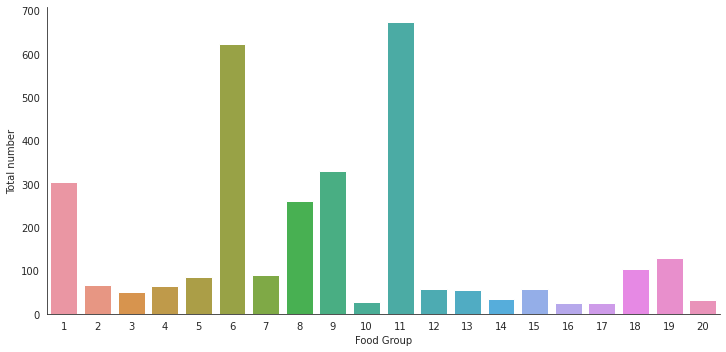

In [73]:
with sns.axes_style('white'):
    g = sns.catplot("식품군", data=data_nf, aspect=2.0,kind='count')
    g.set_xlabels("Food Group")
    g.set_ylabels("Total number")

In [74]:
data_nf.dtypes

색인           int64
식품군          int64
식품코드        object
식품명K        object
식품명E        object
에너지         object
수분          object
단백질         object
지질          object
포화지방산       object
단일불포화지방산    object
다중불포화지방산    object
오메가3지방산     object
오메가6지방산     object
콜레스테롤       object
탄수화물        object
식이섬유        object
수용성 식이섬유    object
불용성 식이섬유    object
당류          object
자당          object
포도당         object
과당          object
칼슘          object
철           object
마그네슘        object
인           object
칼륨          object
나트륨         object
아연          object
구리          object
망간          object
셀레늄         object
몰리브덴        object
요오드         object
레티놀         object
베타카로틴       object
비타민 B1      object
비타민 B2      object
니아신         object
엽산 첨가 엽산    object
비타민 B12     object
비타민 C       object
비타민 D       object
비타민 D2      object
비타민 D3      object
비타민 E       object
비타민 K       object
비타민 K1      object
비타민 K2      object
dtype: object

In [75]:
data_nf.iloc[:, 5:] = data_nf.iloc[:, 5:].apply(pd.to_numeric, errors='coerce')

In [76]:
data_nf.dtypes

색인            int64
식품군           int64
식품코드         object
식품명K         object
식품명E         object
에너지           int64
수분          float64
단백질         float64
지질          float64
포화지방산       float64
단일불포화지방산    float64
다중불포화지방산    float64
오메가3지방산     float64
오메가6지방산     float64
콜레스테롤       float64
탄수화물        float64
식이섬유        float64
수용성 식이섬유    float64
불용성 식이섬유    float64
당류          float64
자당          float64
포도당         float64
과당          float64
칼슘            int64
철           float64
마그네슘          int64
인             int64
칼륨            int64
나트륨           int64
아연          float64
구리          float64
망간          float64
셀레늄         float64
몰리브덴        float64
요오드         float64
레티놀           int64
베타카로틴         int64
비타민 B1      float64
비타민 B2      float64
니아신         float64
엽산 첨가 엽산      int64
비타민 B12     float64
비타민 C       float64
비타민 D       float64
비타민 D2      float64
비타민 D3      float64
비타민 E       float64
비타민 K       float64
비타민 K1      float64
비타민 K2      float64


In [77]:
data_nf['Portion'] = '100'
data_nf['Intake_time'] = '1'
data_nf

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2,Portion,Intake_time
0,1,1,A001001A010a,"귀리, 겉귀리, 도정, 생것","Oat(Covered oat), Polished, Raw",373,9.40,11.40,3.70,0.000,0.000,0.000,0.00,0.00,0.00,73.50,0.0,0.0,0.0,0.00,0.00,0.00,0.00,16,6.60,0,175,574,2,0.00,0.000,0.000,0.00,0.00,0.00,0,0,0.130,0.210,2.300,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,100,1
1,2,1,A001002A010a,"귀리, 쌀귀리, 도정, 생것","Oat(Naked oat), Polished, Raw",371,9.70,14.30,3.80,0.000,0.000,0.000,0.00,0.00,0.00,70.40,0.0,0.0,0.0,0.00,0.00,0.00,0.00,18,7.00,0,183,385,3,0.00,0.000,0.000,0.00,0.00,0.00,0,0,0.150,0.460,2.200,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,100,1
2,3,1,A0020000009a,"귀리, 오트밀","Oat, Oatmeal",382,12.00,13.20,8.20,0.000,0.000,0.000,0.00,0.00,0.00,64.90,18.8,5.2,13.6,0.00,0.00,0.00,0.00,60,5.80,0,381,383,4,0.00,0.000,0.000,0.00,0.00,0.00,0,3,0.000,0.070,1.100,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,100,1
3,4,1,A003000A010a,"기장, 도정, 생것","Prosomillet, Polished, Raw",360,11.30,11.20,1.90,0.000,0.000,0.000,0.00,0.00,0.00,74.60,0.0,0.0,0.0,0.00,0.00,0.00,0.00,15,2.80,0,226,233,6,0.00,0.000,0.000,0.00,0.00,0.00,0,0,0.420,0.090,2.900,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,100,1
4,5,1,A003001A010a,"기장, 찰기장, 도정, 생것","Prosomillet, Glutinous, Polished, Raw",365,11.30,12.46,3.09,0.460,0.530,1.950,0.04,1.91,0.00,71.91,4.6,0.4,4.2,0.00,0.00,0.00,0.00,8,2.71,106,286,203,2,1.87,0.241,0.665,7.20,16.60,0.00,0,10,0.417,0.078,2.213,0,0.00,0.00,0.00,0.00,0.00,1.54,0.00,0.00,0.00,100,1
5,6,1,A004000A010a,"메밀, 도정, 생것","Buckwheat, Polished, Raw",363,13.10,13.64,3.38,0.710,1.270,1.250,0.08,1.17,0.00,67.84,6.3,0.7,5.6,0.50,0.00,0.00,0.00,21,2.78,244,453,444,1,3.09,0.541,1.469,3.16,37.62,1.07,0,7,0.458,0.255,5.189,0,0.00,0.00,0.00,0.00,0.00,5.17,1.52,1.52,0.00,100,1
6,7,1,A004000A015a,"메밀, 도정, 가루","Buckwheat, Polished, Powder",374,10.50,12.96,3.29,0.700,1.220,1.230,0.08,1.15,0.00,71.36,8.5,1.9,6.6,0.37,0.00,0.00,0.00,17,2.92,227,435,432,1,2.99,0.522,1.478,2.67,28.46,3.26,0,9,0.341,0.274,1.724,0,0.00,0.00,0.00,0.00,0.00,5.37,3.42,3.42,0.00,100,1
7,8,1,A0050000000a,"메밀 국수, 생것","Buckwheat noodle, Wet noodle",291,28.80,7.59,0.96,0.270,0.110,0.540,0.03,0.51,0.00,61.14,1.9,0.5,1.4,0.00,0.00,0.00,0.00,13,0.59,21,64,116,455,0.30,0.074,0.442,6.13,5.71,3.67,0,0,0.015,0.050,0.998,0,0.00,0.00,0.00,0.00,0.00,0.53,0.00,0.00,0.00,100,1
8,9,1,A0050000000b,"메밀 국수, 생것, 삶은것","Buckwheat noodle, Wet noodle, Boiled",124,70.10,3.54,0.44,0.130,0.050,0.240,0.01,0.23,0.00,25.73,1.7,0.1,1.6,0.00,0.00,0.00,0.00,7,0.28,4,21,7,38,0.21,0.030,0.145,2.90,2.21,1.40,0,6,0.009,0.018,0.149,0,0.00,0.00,0.00,0.00,0.00,0.35,0.00,0.00,0.00,100,1
9,10,1,A0050000001a,"메밀 국수, 말린것","Buckwheat noodle, Dry noodle",372,8.30,13.58,1.27,0.380,0.230,0.610,0.03,0.58,0.00,74.41,4.6,0.8,3.8,2.77,0.00,0.90,0.00,28,2.54,83,173,198,707,1.64,0.360,1.388,7.03,21.38,0.95,0,0,0.119,0.120,1.475,0,0.00,1.07,0.00,0.00,0.00,0.14,0.00,0.00,0.00,100,1


In [78]:
g_grain = ['1', '2']

g_pulse = ['4']
g_nut = ['5']
g_meat = ['9']
g_egg = ['10']
g_fish = ['11']

g_vegetable = ['6', '7', '12']
g_fat = ['5', '14']
g_milk = ['13']
g_fruit = ['8']
g_other = ['3', '15', '16', '17', '18', '19', '20']

In [79]:
# Group 2 recommendation

In [ ]:
# 11. 어패류 및 기타 수산물 (FISHES)

df_fish = data_nf.loc[data_nf['식품군'].isin(g_fish)]

df_f_80 = df_fish[df_fish['식품명K'].str.contains('조개') | df_fish['식품명K'].str.contains('꽃게') | 
               df_fish['식품명K'].str.contains('오징어') | df_fish['식품명K'].str.contains('낙지') | df_fish['식품명K'].str.contains('새우')]
df_f_80.iloc[:, 5:-2] = 0.8*df_f_80.iloc[:, 5:-2]
df_f_80['Portion'] = '80'
df_f_80['Intake_time'] = '1'

df_f_60 = df_fish[~df_fish['식품명K'].str.contains('조개') | ~df_fish['식품명K'].str.contains('꽃게') | 
               ~df_fish['식품명K'].str.contains('오징어') | ~df_fish['식품명K'].str.contains('낙지') | ~df_fish['식품명K'].str.contains('새우')]
df_f_60.iloc[:, 5:-2] = 0.6*df_f_60.iloc[:, 5:-2]
df_f_60['Portion'] = '60'
df_f_60['Intake_time'] = '1'

df_fish = pd.concat([df_f_60, df_f_80])

#chosen_idx = np.random.choice(len(df_fish.index), replace = True, size = 2)
#df_fish_rec = df_fish.iloc[chosen_idx] 

#df_fish_rec

In [ ]:
# 9. 육류 (MEATS)

df_meat = data_nf.loc[data_nf['식품군'].isin(g_meat)]

df_m = df_meat[df_meat['식품명K'].str.contains('국물') | df_meat['식품명K'].str.contains('육수')]
df_m.iloc[:, 5:-2] = df_m.iloc[:, 5:-2]
df_m['Portion'] = '100'
df_m['Intake_time'] = '1'

df_m_60 = df_meat[~df_meat['식품명K'].str.contains('국물') | ~df_meat['식품명K'].str.contains('육수')]
df_m_60.iloc[:, 5:-2] = 0.6*df_m_60.iloc[:, 5:-2]
df_m_60['Portion'] = '60'
df_m_60['Intake_time'] = '1'

df_meat = pd.concat([df_m, df_m_60])

#chosen_idx = np.random.choice(len(df_meat.index), replace = True, size = 2)
#df_meat_rec = df_meat.iloc[chosen_idx] 

#df_meat_rec

In [ ]:
# 10. 난류 (EGGS)

df_egg = data_nf.loc[data_nf['식품군'].isin(g_egg)]

df_egg.iloc[:, 5:-2] = 0.6*df_egg.iloc[:, 5:-2]
df_egg['Portion'] = '60'
df_egg['Intake_time'] = '1'

#chosen_idx = np.random.choice(len(df_egg.index), replace = True, size = 2)
#df_egg_rec = df_egg.iloc[chosen_idx] 

#df_egg_rec

In [ ]:
# 4. 두류 (PULSES)

df_pulse = data_nf.loc[data_nf['식품군'].isin(g_pulse)]

df_p_200 = df_pulse[df_pulse['식품명K'].str.contains('두유')]
df_p_200.iloc[:, 5:-2] = 2.0*df_p_200.iloc[:, 5:-2]
df_p_200['Portion'] = '200'
df_p_200['Intake_time'] = '1'

df_p_80 = df_pulse[df_pulse['식품명K'].str.contains('두부')]
df_p_80.iloc[:, 5:-2] = 0.8*df_p_80.iloc[:, 5:-2]
df_p_80['Portion'] = '80'
df_p_80['Intake_time'] = '1'

df_p_20 = df_pulse[~df_pulse['식품명K'].str.contains('두부') | ~df_pulse['식품명K'].str.contains('두유')]
df_p_20.iloc[:, 5:-2] = 0.2*df_p_20.iloc[:, 5:-2]
df_p_20['Portion'] = '20'
df_p_20['Intake_time'] = '1'

df_pulse = pd.concat([df_p_20, df_p_80, df_p_200])

#chosen_idx = np.random.choice(len(df_pulse.index), replace = True, size = 1)
#df_pulse_rec = df_pulse.iloc[chosen_idx] 

#df_pulse_rec

In [ ]:
# 5. 견과류 및 종실류 (NUTS AND SEEDS)

df_nut = data_nf.loc[data_nf['식품군'].isin(g_nut)]

df_nut.iloc[:, 5:-2] = 0.1*df_nut.iloc[:, 5:-2]
df_nut['Portion'] = '10'
df_nut['Intake_time'] = '0.5'

#chosen_idx = np.random.choice(len(df_nut.index), replace = True, size = 1)
#df_nut_rec = df_nut.iloc[chosen_idx] 

#df_nut_rec

In [114]:
# Group 2 (11, 9, 10, 4, 5)

df_group2 = pd.concat([df_fish, df_meat, df_egg, df_pulse, df_nut])

In [166]:
chosen_idx = np.random.choice(len(df_group2.index), replace = True, size = 4)
df_group2_rec = df_group2.iloc[chosen_idx] 

df_group2_rec

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2,Portion,Intake_time
1810,1731,9,I028001D579b,"소 부산물, 미국산, 허파, 삶은것","Beef edible offal, USA, Lung, Boiled",72.0,45.84,12.240,2.220,0.762,0.570,0.306,0.000,0.000,166.200,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.6,3.240,6.0,106.8,103.8,60.6,0.984,0.1326,0.009,30.180,0.00,0.0,7.2,0.0,0.021,0.0858,1.4952,0.0,1.554,19.62,0.0,0.0,0.0,0.000,0.0,0.0,0.0,60,1
1599,1558,9,I014000D039b,"돼지고기, 갈비, 삶은것","Pork meat, Shoulder rib, Boiled",173.4,29.94,15.906,11.724,3.996,4.482,1.278,0.096,1.182,62.118,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.8,0.654,10.8,90.6,99.6,27.0,2.226,0.0420,0.000,9.018,0.66,0.0,0.0,0.0,0.147,0.0618,0.9936,0.0,0.570,0.42,0.0,0.0,0.0,0.042,0.0,0.0,0.0,60,1
1924,1839,11,K0100020000a,"갈치, 동동갈치, 생것","Channel scabbardfish(Evoxymetopon taeniatus), ...",72.6,44.76,12.000,2.340,0.000,0.000,0.000,0.000,0.000,0.000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.000,0.0000,0.000,0.000,0.00,0.0,0.0,0.0,0.000,0.0000,0.0000,0.0,0.000,0.00,0.0,0.0,0.0,0.000,0.0,0.0,0.0,60,1
2271,2186,11,K1570000000a,"전어, 생것","Dotted gizzard shad(Konosirus punctatus), Raw",64.2,45.42,11.520,1.620,0.000,0.000,0.000,0.000,0.000,0.000,0.12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,84.6,0.720,0.0,186.6,0.0,0.0,0.000,0.0000,0.000,0.000,0.00,0.0,0.0,0.0,0.012,0.1740,3.6600,0.0,0.000,0.00,0.0,0.0,0.0,0.000,0.0,0.0,0.0,60,1


In [162]:
def fish_meat(df, recom):
  energy = pd.Series(df["recom_EN"])

  if ((energy >= 1000).any() & (energy < 1100).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 1))
    df_group2_rec = df_group2.iloc[chosen_idx]
  elif ((energy >= 1100).any() & (energy < 1300).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 2))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 1300).any() & (energy < 1700).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 2))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 1700).any() & (energy < 1800).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 3))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 1800).any() & (energy < 1900).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 3))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 1900).any() & (energy < 2100).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 4)) 
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 2100).any() & (energy < 2200).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 4))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 2200).any() & (energy < 2500).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 5))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif ((energy >= 2500).any() & (energy < 2600).any()):
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 6))    
    df_group2_rec = df_group2.iloc[chosen_idx] 
  elif (energy >= 2600).any():
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 6))
    df_group2_rec = df_group2.iloc[chosen_idx] 
  else:
    chosen_idx = (np.random.choice(len(df_group2.index), replace = True, size = 0))
    df_group2_rec = df_group2.iloc[chosen_idx]
df_group2_rec

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2,Portion,Intake_time
2148,2063,11,K1030010000a,"빙어, 바다빙어, 생것",Rainbow smelt(Osmerus mordax dentex Steindachn...,55.2,47.64,10.44,1.14,0.0,0.0,0.0,0.0,0.0,0.0,0.06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13.8,0.84,0.0,140.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.6,0.0,0.096,0.102,2.28,0.0,0.0,0.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60,1


In [156]:
df['r_g2'] = df.apply(fish_meat(df, recom_EN=2110), axis=1)

TypeError: ignored

In [ ]:
df_g = data_nf.loc[data_nf['식품군'].isin(g_grain_)]
#chosen_idx = np.random.choice(100, replace = True, size = 3)
#df_grain = df_g.iloc[chosen_idx] 

 
df_grain

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
53,54,1,A0090030009j,"멥쌀 과자, 튀밥, 팽화","Rice snack, Puffed rice",393,5.6,8.7,3.9,0,0,0,0,0,0,80.7,0,0,0,0,0,0,0,5,1,0,228,278,74,0,0,0,0,0,0,0,0,0.16,0.04,1.6,0,0,0,0,0,0,0,0,0,0
95,96,1,A015000A039a,"멥쌀죽, 백미","Rice porridge, White rice",71,82.9,1.4,0,0,0,0,0,0,0,15.6,0,0,0,0,0,0,0,2,0.7,0,13,6,3,0,0,0,0,0,0,0,0,0.01,0.01,0.4,0,0,0,0,0,0,0,0,0,0
3,4,1,A003000A010a,"기장, 도정, 생것","Prosomillet, Polished, Raw",360,11.3,11.2,1.9,0,0,0,0,0,0,74.6,0,0,0,0,0,0,0,15,2.8,0,226,233,6,0,0,0,0,0,0,0,0,0.42,0.09,2.9,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_vegetable = data_nf.loc[data_nf['식품군'].isin(g_vegetable)]
df_vegetable

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
570,566,6,F001000B110a,"가시오갈피, 순, 생것",0,76,76,5.67,0.7,0.18,0.05,0.44,0.21,0.23,0,15.87,8.8,4.3,4.5,4.56,0,0.73,1.06,211,3.43,55,104,678,1,1.18,0.157,4.876,1.44,5.14,6.32,0,9728,0.213,0.615,1.487,0,0,100.73,0,0,0,8.44,287.26,287.26,0
571,567,6,F001000B119c,"가시오갈피, 순, 데친것",0,63,80.5,5.25,0.85,0.14,0.07,0.6,0.39,0.21,0,11.99,11.1,4.6,6.5,2.07,1.34,0,0.39,184,2.2,47,86,469,1,0.98,0.147,4.378,0.65,3.53,0,0,5613,0.276,0.386,0.937,0,0,62.05,0,0,0,7.04,274.37,274.37,0
572,568,6,F0020000000a,"가죽나물, 생것","Ailanthus altissima, Young leaf bud, Raw",50,83.4,5.33,0.41,0.1,0,0.29,0.17,0.12,0,9.46,4.9,0.6,4.3,0,0,0,0,137,2.5,49,117,487,5,1.07,0.177,0.734,4.37,0.85,2.93,0,1192,0.563,0.532,0.829,0,0,2.52,0,0,0,0.69,280.25,280.25,0
573,569,6,F0020000001a,"가죽나물, 말린것","Ailanthus altissima, Young leaf bud, Dried",287,9.1,22.4,6.3,0,0,0,0,0,0,50.2,42.8,1.8,40.9,0,0,0,0,1051,12.8,0,249,998,0,0,0,0,0,0,0,0,25678,0.82,1.67,2.7,0,0,0,0,0,0,0,0,0,0
574,570,6,F0020000009c,"가죽나물, 데친것","Ailanthus altissima, Young leaf bud, Blanched",49,84.4,4.78,0.51,0.11,0,0.37,0.24,0.13,0,9.25,5.9,1.1,4.8,0,0,0,0,131,1.63,39,100,343,3,0.81,0.141,0.48,3.18,0.71,0.71,0,2519,0.062,0.239,0.158,0,0,1.77,0,0,0,3.09,306.43,306.43,0
575,571,6,F0030000000a,"가지, 생것","Eggplant(Solanum melongena L.), Raw",19,93.9,1.13,0.03,0.03,0,0,0,0,0,4.36,2.7,0.4,2.3,2.32,0,1.09,1.23,16,0.26,15,35,232,0,0.55,0.043,0.118,0,4.59,0,0,52,0.035,0.163,0.366,0,0,0,0,0,0,0,0,0,0
576,572,6,F0030000001a,"가지, 말린것","Eggplant(Solanum melongena L.), Dried",290,8.9,14.53,2.4,0.98,0.07,1.15,0.3,0.85,0,65.59,29.4,8.1,21.3,18.13,5.72,5.58,6.83,235,3.47,227,496,3471,13,2.89,0.892,1.625,2.42,75.27,1.82,0,511,0.125,0.772,3.315,0,0,0,0,0,0,0,60.03,60.03,0
577,573,6,F0030000009c,"가지, 데친것","Eggplant(Solanum melongena L.), Blanched",19,94,1,0.1,0.03,0,0.06,0.02,0.04,0,4.4,3.4,1.7,1.7,1.94,0,0.94,1,17,0.32,14,27,179,1,0.38,0.03,0.114,0,4.3,0,0,125,0.018,0.086,0.326,0,0,0,0,0,0,0,0,0,0
578,574,6,F003000000Ia,"가지, 염절임","Eggplant(Solanum melongena L.), Salted",23,90.4,1.4,0.1,0,0,0,0,0,0,5.2,2.7,0.5,2.2,0,0,0,0,18,0.6,18,33,260,880,0.2,0.09,0.18,0,0,0,0,44,0.03,0.04,0.4,0,0,7,0,0,0,0.3,10,0,0
579,575,6,F0040000000a,"갓, 생것","Mustard(Brassica juncea (L.) Czern.), Raw",36,87.8,3.5,0.2,0,0,0,0,0,0,7.3,0,0,0,0,0,0,0,193,2.7,0,59,378,33,0,0,0,0,0,0,0,1183,0.24,0.16,1.2,0,0,135,0,0,0,0,0,0,0


In [ ]:
df_fat = data_nf.loc[data_nf['식품군'].isin(g_fat)]
df_fat

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
486,480,5,E0010000001a,"개암, 헤이즐넛, 말린것","Hazelnut, Dried",659,4.7,19.8,58.5,0,0,0,0,0,0,13.4,0,0,0,0,0,0,0,312,3.7,0,784,967,0,0,0,0,0,0,0,0,0,0.07,0.22,7,0,0,0,0,0,0,0,0,0,0
487,481,5,E0010000009n,"개암, 헤이즐넛, 볶은것","Hazelnut, Roasted and salted",684,1,13.6,69.3,6.21,54.74,5.31,0.07,5.24,0,13.9,7.4,0.9,6.5,0,0,0,0,130,3,160,320,610,35,2,1.64,5.24,1,6,0,0,0,0.26,0.28,1,0,0,0,0,0,0,28.3,4,0,0
488,482,5,E0020000000a,"도토리, 생것","Acorn, Raw",230,44.9,4.4,3,0,0,0,0,0,0,46.7,0,0,0,0,0,0,0,16,0.6,0,84,0,0,0,0,0,0,0,0,0,13,0.01,0.06,0.8,0,0,9,0,0,0,0,0,0,0
489,483,5,E0020000005a,"도토리, 가루","Acorn, Powder",354,13.8,1.1,1.1,0,0,0,0,0,0,83.7,0,0,0,0,0,0,0,60,3.3,0,17,3,2,0,0,0,0,0,0,0,0,0.02,0.03,0.2,0,0,0,0,0,0,0,0,0,0
490,486,5,E0030000001a,"도토리 국수, 말린것","Noodle, Acorn starch, Dry noodle",343,10.9,12.4,0.7,0,0,0,0,0,0,72.2,0,0,0,0,0,0,0,86,2.3,0,123,258,517,0,0,0,0,0,0,0,0,0.87,0,3.9,0,0,0,0,0,0,0,0,0,0
491,487,5,E0040000009a,도토리묵,Acorn starch jelly,47,88.1,0.33,0.11,0.03,0.05,0.03,0,0.02,0,11.23,0,0,0,0,0,0,0,15,0.23,3,3,12,76,0.23,0.014,0.235,1.89,0,0,0,4,0.047,0,0.06,0,0,0,0,0,0,0.42,0,0,0
492,3071,5,E0040000005a,"도토리묵, 가루","Acorn starch jelly, Powder",366,9.7,1.7,1.23,0.22,0.57,0.25,0.02,0.23,0,87.09,0,0,0,0.01,0.01,0,0,56,1.19,7,15,78,5,0.59,0.124,1.356,0.66,0.53,13.28,0,6,0.029,0.046,0.305,0,0,0,0,0,0,0.64,0,0,0
493,488,5,E0050000001a,"들깨, 말린것","Perilla seed, Dried",530,4.6,22.68,39.74,2.94,4.93,29.98,24.78,5.19,0,29.26,22,1.4,20.6,1.46,1.46,0,0,391,7.74,254,716,583,1,4.8,1.207,3.695,1.16,14.02,0,0,33,0.353,0.759,2.58,0,0,0,0,0,0,27.21,0,0,0
494,3001,5,E0050000009n,"들깨, 볶은것","Perilla seed, Roasted",532,0.9,23.59,36.23,2.86,4.36,28.24,23.82,4.42,0,35.53,22,1.4,20.6,1.48,0,0,0,416,7.5,315,726,599,5,6.78,1.861,4.611,6.1,82.74,2.57,0,29,0.528,0.311,4.362,0,0,0,0,0,0,9.78,0,0,0
495,489,5,E0070000001a,"땅콩, 말린것","Peanut(Arachis hypogaea), Dried",520,10.8,25.74,42.57,8.04,17.27,15.81,0.03,15.78,0,18.36,13.4,0.6,12.8,4.4,4.4,0,0,67,3.07,182,425,746,5,3.38,0.748,1.594,4.58,222.11,1.56,0,4,0.389,0.212,10.514,0,0,0,0,0,0,18.56,0,0,0


In [ ]:
df_milk = data_nf.loc[data_nf['식품군'].isin(g_milk)]
df_milk

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
2629,2544,13,M0010000009a,모유,Human milk,65,88,1.1,3.5,1.32,1.52,0.61,0.09,0.52,15,7.2,0,0,0,0,0,0,0,27,0.04,3,14,48,15,0.3,0.03,0,2,0,0,45,0,0.01,0.03,0.2,0,0,5,0.3,0,0,0.5,1,0,0
2630,2545,13,M0020010009a,"분유, 1단계","Infant formular, The first 3 months",508,2.1,12.41,25.75,11.35,6.31,6.41,0.7,5.72,50.95,56.88,0,0,0,49.01,0,0.78,0,553,3.98,56,323,697,164,4.07,0.302,0.044,12.87,10.22,128.23,549,93,0.644,0.604,6.56,0,4.65,100.5,7.73,0,7.73,12.37,0,43.58,0
2631,2546,13,M0020020009a,"분유, 2단계","Infant formular, Between the ages of 4 and 6 m...",506,2,12.63,25.38,11.34,6.19,6.19,0.68,5.52,53.05,56.93,0,0,0,49,0,0.86,0,635,5.72,60,374,739,171,4.01,0.301,0.06,13.69,11.22,119.96,481,107,0.627,0.671,5.231,0,4.12,93.29,8.1,0,8.1,12.46,0,38.59,0
2632,2547,13,M0020030009a,"분유, 3단계","Infant formular, Between the ages of 7 and 12 ...",477,2.5,16.91,20.65,9.35,5.08,4.84,0.55,4.29,61.33,56.04,0,0,0,43.85,0,0,0,851,7.9,71,519,929,185,4.12,0.307,0.074,18.83,17.08,134.93,520,109,0.637,0.723,6.122,0,5.54,82.98,8.71,0,8.71,12.67,0,38.73,0
2633,2548,13,M0020040009a,"분유, 전지","Milk powder, Whole milk",509,2.7,25.46,27.32,18.02,6.01,0.83,0.08,0.75,83.8,39.07,0,0,0,38.63,0,0,0,977,0.13,89,770,1298,322,2.57,0.009,0.018,34.48,21.68,123.35,418,7,0.168,1.064,0.913,0,1.98,8.41,0,0,0,0.49,0,0,0
2634,2549,13,M0020050009a,"분유, 탈지","Milk powder, Skim milk",358,4.3,33.88,0.97,0.63,0.2,0.05,0,0.05,26.15,53.16,0,0,0,46.17,0,0,0,1414,0.15,120,1068,1665,432,3.82,0.012,0.024,42.39,21.91,168.92,0,0,0.158,1.314,1.266,0,3.86,10.1,0,0,0,0,0,0,0
2635,2550,13,M0030000009a,산양유,Goat's milk,62,88.4,3.16,3.62,2.47,0.74,0.09,0.01,0.08,16.47,4.03,0,0,0,3.48,0,0,0,149,0.03,16,134,201,40,0.51,0.006,0.008,3.32,1.02,46.9,67,0,0,0.034,0.215,0,0,0.33,0,0,0,0,0,0,0
2636,2551,13,M0040000009a,샤베트,Sherbet,127,69.1,0.9,1,0.77,0.18,0.04,0,0.04,1,28.7,0,0,0,0,0,0,0,22,0.1,3,22,95,13,0.1,0.01,0.09,0,0,0,0,0,0.04,0.05,0.2,0,0,0,0,0,0,0,1,0,0
2637,2552,13,M0050000009a,아이스밀크,Ice milk,167,65.6,3.4,6.4,4.64,1.35,0.16,0.02,0.13,18,23.9,0,0,0,0,0,0,0,110,0.1,14,100,140,75,0.3,0,0.01,0,0,0,21,0,0.03,0.14,0.1,0,0.3,0,0.1,0,0,0.1,1,0,0
2638,2553,13,M0060001389a,"아이스크림, 딸기맛",0,192,60,3.2,8.4,5.19,0,0,0,0,29,27.6,0.9,0,0,4.43,0,0,0,120,0.21,14,100,188,60,0.34,0.037,0.078,1.9,0,0,96,0,0.045,0.255,0.17,0,0.3,7.7,0,0,0,0,0,0,0


In [ ]:

df_fruit = data_nf.loc[data_nf['식품군'].isin(g_fruit)]
df_fruit

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
1281,1256,8,H0010000710a,"감, 탈삽, 생것",0,63,82.2,0.5,0.1,0,0,0,0,0,0,16.9,2.8,0.5,2.3,13.6,2.6,5.8,5.2,7,0.1,6,16,200,1,0,0.02,0.6,0,0,0,0,100,0.02,0.02,0.3,0,0,55,0,0,0,0.2,0,0,0
1282,1257,8,H0010010000a,"감, 단감, 생것","Persimmon(Diospyros kaki Thunb.), Hard, Raw",51,85.6,0.41,0.04,0.01,0.02,0.01,0.01,0,0,13.66,6.4,2.9,3.5,10.52,0,5.39,5.13,6,0.15,5,15,132,0,0,0.018,0.694,0.61,0.33,0,0,81,0.057,0.051,0.305,0,0,13.95,0,0,0,0.07,0,0,0
1283,1258,8,H0010020000a,"감, 대봉(갑주백목), 생것","Persimmon(Diospyros kaki Thunb.), Soft(Gapjuba...",70,79.8,0.6,0,0,0,0,0,0,0,18.9,0,0,0,0,0,0,0,18,3.6,0,23,214,2,0,0,0,0,0,0,0,239,0.06,0.07,0.5,0,0,18,0,0,0,0,0,0,0
1284,1259,8,H0010030000a,"감, 둥시, 생것","Persimmon(Diospyros kaki Thunb.), Dungsi, Raw",71,80.1,0.6,0.1,0,0,0,0,0,0,18.8,0,0,0,0,0,0,0,6,0.3,0,12,185,12,0,0,0,0,0,0,0,16,0.07,0.08,1.6,0,0,28,0,0,0,0,0,0,0
1285,1260,8,H0010030001a,"감, 둥시, 말린것","Persimmon(Diospyros kaki Thunb.), Dungsi, Dried",223,36.7,1.59,0.05,0.02,0.02,0.01,0.01,0,0,60.45,15.2,2.8,12.4,24.25,0,13.56,10.69,22,0.74,21,69,584,1,0.22,0.032,0.766,0.63,2.18,1.09,0,298,0,0.59,0,0,0,2.37,0,0,0,1.16,0,0,0
1286,1261,8,H0010040000a,"감, 연시, 생것","Persimmon(Diospyros kaki Thunb.), Soft, Raw",65,81.6,0.29,0.04,0.01,0.01,0.01,0.01,0,0,17.76,6.5,0.7,5.8,12.32,0,6.34,5.98,8,0.12,8,23,171,1,0.1,0,0.464,0.25,0.14,0,0,308,0.028,0,0.221,0,0,1.22,0,0,0,0.12,0,0,0
1287,1262,8,H0010040007a,"감, 연시, 냉동","Persimmon(Diospyros kaki Thunb.), Soft, Frozen",66,81.2,0,0.04,0.02,0.02,0.01,0.01,0,0,18.36,2.2,0,2.2,10.35,4.15,0,6.2,21,0,23,69,547,0,0.13,0,1.148,0,0.33,0,0,269,0.053,0.191,0.222,0,0,2.43,0,0,0,0.21,0,0,0
1288,1263,8,H0020010009a,"감, 잼, 단감","Persimmon(Diospyros kaki Thunb.), Jam, Hard",225,42.8,0.3,0.1,0,0,0,0,0,0,55.7,0,0,0,0,0,0,0,5,0.7,0,6,123,13,0,0,0,0,0,0,0,0,0.04,0.27,1.5,0,0,10,0,0,0,0,0,0,0
1289,1264,8,H0040000009a,감 주스,Persimmon(Diospyros kaki Thunb.) juice,41,88.6,0.1,0.1,0,0,0,0,0,0,11,0,0,0,0,0,0,0,8,0,0,9,87,6,0,0,0,0,0,0,0,128,0.01,0.01,0.3,0,0,1,0,0,0,0,0,0,0
1290,1265,8,H0050000001a,"감말랭이, 말린것","Persimmon(Diospyros kaki Thunb.), Dried, Cubed",255,27.9,1.94,0.16,0.04,0.08,0.03,0.03,0,0,68.61,11.2,6.4,4.8,55.11,0,31.25,23.86,21,0.64,24,78,647,3,0,0.041,0.979,1.09,1.77,3.07,0,549,0.01,0.224,0.688,0,0,5.11,0,0,0,0.18,0,0,0


In [ ]:
df_other = data_nf.loc[data_nf['식품군'].isin(g_other)]
df_other

,색인,식품군,식품코드,식품명K,식품명E,에너지,수분,단백질,지질,포화지방산,단일불포화지방산,다중불포화지방산,오메가3지방산,오메가6지방산,콜레스테롤,탄수화물,식이섬유,수용성 식이섬유,불용성 식이섬유,당류,자당,포도당,과당,칼슘,철,마그네슘,인,칼륨,나트륨,아연,구리,망간,셀레늄,몰리브덴,요오드,레티놀,베타카로틴,비타민 B1,비타민 B2,니아신,엽산 첨가 엽산,비타민 B12,비타민 C,비타민 D,비타민 D2,비타민 D3,비타민 E,비타민 K,비타민 K1,비타민 K2
371,366,3,C0010000009a,과당,Fructose,368,0.1,0,0,0,0,0,0,0,0,99.9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
372,367,3,C0020010009a,"껌, 츄잉껌","Gum, Chewing gum",388,3.1,0,0,0,0,0,0,0,0,96.9,0,0,0,0,0,0,0,3,0.1,0,0,3,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
373,368,3,C0020020009a,"껌, 풍선껌","Gum, Bubble gum",387,3.3,0,0,0,0,0,0,0,0,96.7,0,0,0,0,0,0,0,3,0.1,0,0,4,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
374,369,3,C0020030009a,"껌, 무설탕","Chewing Gum, Sugar free",268,3.5,0,0.4,0.058,0.093,0.232,0,0,0,94.8,2.4,0,0,0,0,0,0,20,0,0,0,0,7,0,0,0,0.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
375,370,3,C0030000009a,꿀,Honey,294,20,0.2,0,0,0,0,0,0,0,79.7,0,0,0,72.6,0.2,32.3,38.6,1,1,1,4,18,6,1,0.05,0,0,0,0,0,0,0,0.01,0.1,0,0,0,0,0,0,0,0,0,0
376,371,3,C0030010009a,"꿀, 들깨","Honey, Perilla",292,20.6,0.4,0,0,0,0,0,0,0,79,0,0,0,0,0,0,0,0,0,0,0,38,9,0,0,0,0,0,0,0,0,0.02,0.01,0.2,0,0,0,0,0,0,0,0,0,0
377,372,3,C0030020009a,"꿀, 밤","Honey, Chestnut",314,14.2,0.45,0.02,0.02,0,0,0,0,0,84.91,0.8,0.2,0.6,67.36,0,25.44,41.92,18,0.25,9,8,248,1,0.06,0.024,1.561,1.98,0.42,1.27,0,0,0,0.516,0.918,0,0,0.08,0,0,0,0,0,0,0
378,373,3,C0030030009a,"꿀, 싸리","Honey, Bush clover",315,14.3,0.3,0,0,0,0,0,0,0,85.4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.01,0.3,0,0,0,0,0,0,0,0,0,0
379,374,3,C0030040009a,"꿀, 아카시아","Honey, Acacia",319,13.3,0.12,0,0,0,0,0,0,0,86.49,0,0,0,74.68,0,27.8,46.88,3,0.02,1,3,20,0,0,0,0.015,1.52,0.09,0.55,0,0,0,0.403,0.052,0,0,0,0,0,0,0,0,0,0
380,375,3,C0030050009a,"꿀, 잡화","Honey, Polyfloral",318,13.3,0.26,0.02,0.01,0,0,0,0,0,86.05,0,0,0,75.96,0,31.62,44.34,7,0.11,6,9,156,1,0.05,0.028,0.749,0.3,0.24,0,0,0,0,1.519,0.236,0,0,0,0,0,0,0,0,0,0


In [ ]:
print(df_grain.shape, df_fish_meat.shape, df_vegetable.shape, df_fruit.shape, df_fat.shape, df_milk.shape, df_other.shape)

(3, 50) (1095, 50) (768, 50) (260, 50) (117, 50) (55, 50) (422, 50)


In [ ]:
!pip install plotly

You should consider upgrading via the '/home/idblab/anaconda3/envs/jupyter/bin/python -m pip install --upgrade pip' command.


In [ ]:
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
alls=['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20']

prot= data_nf[data_nf['식품군'].isin(alls)]
protein_rich= prot.sort_values(by='에너지', ascending= False)
top_20=protein_rich.head(20)
fig = px.bar(top_20, x='식품명K', y='에너지', color = '에너지', title=' Top 10 protein rich foods')
fig.show()

In [ ]:
meat= data_nf[data_nf['식품군'].isin(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20'])]
top_10_fattest= meat.sort_values(by='지질', ascending=False)
top_10_fattest=top_10_fattest.head(10)
fig = go.Figure(data=[go.Scatter(
    x=top_10_fattest['식품명K'], y=top_10_fattest['지질'],
    mode='markers',
    marker_size=[200,180,160,140,120, 100 ,80 , 60 ,40,20])
])
fig.update_layout(title='Meat/Seafood with high Fat Content')
fig.show()

In [ ]:
top_10_fibrous= meat.sort_values(by='오메가3지방산', ascending=False)
top_10_fibrous=top_10_fibrous.head(10)
top_10_fibrous

In [ ]:
data = pd.read_csv('/content/chen/KNHANES/hn16_24rc.csv')

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (32,33) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
percentage=(data.isnull().mean())*100
pd.set_option("max_rows", None)
percentage.sort_values(ascending=False)

NS_VOL        99.996899
N_CD_WT       99.993069
NS_WT         99.992157
NS_AM_U       99.335874
NS_VA_RAE     99.335691
NS_FE         99.335691
NS_PHOS       99.335691
NS_CA         99.335691
NS_CODE       99.335691
NS_B1         99.335691
NS_AM         99.335691
NS_CNAME      99.335691
NS_NAME       99.335691
NS_B2         99.335691
NS_NIAC       99.335691
N_DT_ETC      98.417843
N_BFD_Y       95.862936
N_CNAME       94.573352
N_PRODUCT     94.565144
N_FD_NS       94.279502
N_DT_DS       93.911597
age_month     91.249802
N_TD_WT       89.809189
wt_pfhmnt     80.409092
wt_pfhm       80.409092
wt_nn         63.019231
wt_nnnt       63.019231
wt_hmnt       62.201522
wt_hm         62.201522
wt_pfnt       58.698487
wt_pft        58.698487
occp          26.062721
N_CD_VOL      10.855120
N_TD_VOL      10.855120
edu            8.426434
wt_tot         5.021715
wt_itvex       5.021715
N_FNAME        0.664309
NF_INTK3       0.664309
NF_PUFA        0.664309
NF_MUFA        0.664309
NF_SFA         0

In [ ]:
data.shape

(548239, 129)

In [ ]:
df_24=data.dropna(thresh=274119, axis=1)
print(f"Data shape before cleaning {data.shape}")
print(f"Data shape after cleaning {df_24.shape}")
print(f"We dropped {data.shape[1]- df_24.shape[1]} columns")

Data shape before cleaning (548239, 129)
Data shape after cleaning (548239, 98)
We dropped 31 columns


In [ ]:
df_24.shape

(548239, 98)

In [ ]:
percentage=(df_24.isnull().mean())*100
pd.set_option("max_rows", None)
percentage.sort_values(ascending=False)

occp          26.062721
N_CD_VOL      10.855120
N_TD_VOL      10.855120
edu            8.426434
wt_itvex       5.021715
wt_tot         5.021715
NF_MUFA        0.664309
NF_PUFA        0.664309
NF_N3          0.664309
NF_N6          0.664309
NF_10_0        0.664309
NF_16_0        0.664309
NF_14_0        0.664309
NF_FAT         0.664309
NF_18_0        0.664309
NF_20_0        0.664309
NF_22_0        0.664309
NF_SFA         0.664309
NF_EN          0.664309
NF_VITC        0.664309
NF_WATER       0.664309
NF_14_1        0.664309
NF_INTK3       0.664309
NF_INTK        0.664309
N_FNAME3       0.664309
N_FCODE3       0.664309
N_KINDG2       0.664309
N_KINDG1       0.664309
N_AP           0.664309
N_FM_WT        0.664309
N_FNAME        0.664309
N_FCODE        0.664309
NF_24_0        0.664309
NF_PROT        0.664309
NF_16_1        0.664309
NF_CHO         0.664309
NF_NIAC        0.664309
NF_B2          0.664309
NF_B1          0.664309
NF_RETIN       0.664309
NF_CAROT       0.664309
NF_VA_RAE      0

In [ ]:
df_24.head()

,mod_d,ID,ID_fam,year,region,town_t,apt_t,psu,sex,age,incm,ho_incm,incm5,ho_incm5,edu,occp,wt_hs,wt_itvex,wt_ntr,wt_tot,kstrata,N_DIET,N_DIET_WHY,N_DUSUAL,N_WAT_C,N_PRG,N_DAY,N_MEAL,N_MEAL_T,N_MEAL_P,N_MTYPE,N_MEAL_W,N_DNAME,N_DCODE,N_CD_VOL,N_TD_VOL,N_FCODE,N_FNAME,N_FM_WT,N_AP,N_KINDG1,N_KINDG2,N_FCODE3,N_FNAME3,NF_INTK,NF_INTK3,NF_EN,NF_WATER,NF_PROT,NF_FAT,NF_SFA,NF_MUFA,NF_PUFA,NF_N3,NF_N6,NF_10_0,NF_12_0,NF_14_0,NF_16_0,NF_18_0,NF_20_0,NF_22_0,NF_24_0,NF_14_1,NF_16_1,NF_18_1,NF_20_1,NF_22_1,NF_24_1,NF_18_2N6,NF_18_3N3,NF_18_3N6,NF_18_4,NF_20_2,NF_20_3N6,NF_20_4N6,NF_20_5N3,NF_22_2,NF_22_5,NF_22_6N3,NF_CHOL,NF_CHO,NF_TDF,NF_SUGAR,NF_CA,NF_PHOS,NF_FE,NF_NA,NF_K,NF_VA,NF_VA_RAE,NF_CAROT,NF_RETIN,NF_B1,NF_B2,NF_NIAC,NF_VITC,NS_VITC
0,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,3.0,3.0,4.0,4.0,4.0,7.0,3981.17872,7446.336475,8321.135843,5477.994429,701,1,2,2.0,3.0,8,수요일,5,1000,1,12,9,얼라이브원스데일리,59999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,250
1,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,3.0,3.0,4.0,4.0,4.0,7.0,3981.17872,7446.336475,8321.135843,5477.994429,701,1,2,2.0,3.0,8,수요일,5,1000,1,12,9,네츄럴라이프 칼슘/마그네슘/비타민D,59999,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
2,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,3.0,3.0,4.0,4.0,4.0,7.0,3981.17872,7446.336475,8321.135843,5477.994429,701,1,2,2.0,3.0,8,수요일,2,1230,1,1,2,소갈비찜,70705,150.0,300.0,2002.0,"감자, 대지, 생것",2.844474,1.0,2.0,2.0,2001.0,감자,5.688949,5.688949,3.811596,4.659249,0.114348,0.002276,0.001707,0.000000,0.000569,0.000000,0.000569,0.013085,0.06201,0.030720,0.973948,0.237798,0.06201,0.027876,0.026738,0.000000,0.000000,0.110366,0.0,0.0,0.0,0.493232,0.104677,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.857893,0.153602,0.000000,0.512005,1.877353,0.032996,0.056889,23.438468,0.000000,0.000000,0.000000,0.0,0.003413,0.001536,0.017863,0.597908,
3,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,3.0,3.0,4.0,4.0,4.0,7.0,3981.17872,7446.336475,8321.135843,5477.994429,701,1,2,2.0,3.0,8,수요일,2,1230,1,1,2,소갈비찜,70705,150.0,300.0,16071.0,"후추, 검은후추, 가루",0.030052,1.0,11.0,16.0,16071.0,후추,0.060105,0.060105,0.208563,0.009076,0.006792,0.002464,0.001052,0.000559,0.000754,0.000115,0.000525,0.027213,0.07030,0.022678,0.402904,0.247185,0.00000,0.000000,0.000000,0.012095,0.058206,0.489079,0.0,0.0,0.0,0.000000,0.114900,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.039849,0.014748,0.000385,0.168894,0.100375,0.011720,0.027648,0.662955,0.013223,0.006612,0.079338,0.0,0.000066,0.000132,0.000661,0.000000,
4,2020.01.15.,A651172801,A6511728,2016,1,1,2,A651,1,61,3.0,3.0,4.0,4.0,4.0,7.0,3981.17872,7446.336475,8321.135843,5477.994429,701,1,2,2.0,3.0,8,수요일,2,1230,1,1,2,소갈비찜,70705,150.0,300.0,16027.0,맛술,0.486697,1.0,11.0,16.0,16027.0,맛술,0.973393,0.973393,1.421154,0.621025,0.002920,0.002920,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.345555,0.000000,0.237257,0.009734,0.126541,0.002920,0.311486,0.126541,0.000000,0.000000,0.000000,0.0,0.001849,0.000487,0.009734,0.077871,


In [ ]:
df_24.dtypes

mod_d          object
ID             object
ID_fam         object
year            int64
region          int64
town_t          int64
apt_t           int64
psu            object
sex             int64
age             int64
incm          float64
ho_incm       float64
incm5         float64
ho_incm5      float64
edu           float64
occp          float64
wt_hs         float64
wt_itvex      float64
wt_ntr        float64
wt_tot        float64
kstrata         int64
N_DIET          int64
N_DIET_WHY      int64
N_DUSUAL      float64
N_WAT_C       float64
N_PRG           int64
N_DAY          object
N_MEAL          int64
N_MEAL_T        int64
N_MEAL_P        int64
N_MTYPE         int64
N_MEAL_W        int64
N_DNAME        object
N_DCODE         int64
N_CD_VOL      float64
N_TD_VOL      float64
N_FCODE       float64
N_FNAME        object
N_FM_WT       float64
N_AP          float64
N_KINDG1      float64
N_KINDG2      float64
N_FCODE3      float64
N_FNAME3       object
NF_INTK       float64
NF_INTK3  

In [ ]:
print('Number of missing values across columns-\n', df_24.isnull().sum())

Number of missing values across columns-
 mod_d              0
ID                 0
ID_fam             0
year               0
region             0
town_t             0
apt_t              0
psu                0
sex                0
age                0
incm            1849
ho_incm         1849
incm5           1849
ho_incm5        1849
edu            46197
occp          142886
wt_hs              0
wt_itvex       27531
wt_ntr             0
wt_tot         27531
kstrata            0
N_DIET             0
N_DIET_WHY         0
N_DUSUAL          23
N_WAT_C           23
N_PRG              0
N_DAY             23
N_MEAL             0
N_MEAL_T           0
N_MEAL_P           0
N_MTYPE            0
N_MEAL_W           0
N_DNAME            0
N_DCODE            0
N_CD_VOL       59512
N_TD_VOL       59512
N_FCODE         3642
N_FNAME         3642
N_FM_WT         3642
N_AP            3642
N_KINDG1        3642
N_KINDG2        3642
N_FCODE3        3642
N_FNAME3        3642
NF_INTK         3642
NF_INTK3     

/home/idblab/anaconda3/envs/jupyter/lib/python3.7/site-packages/seaborn/categorical.py:3669: UserWarning: The `factorplot` function has been renamed to `catplot`. The original name will be removed in a future release. Please update your code. Note that the default `kind` in `factorplot` (`'point'`) has changed `'strip'` in `catplot`.
  warnings.warn(msg)


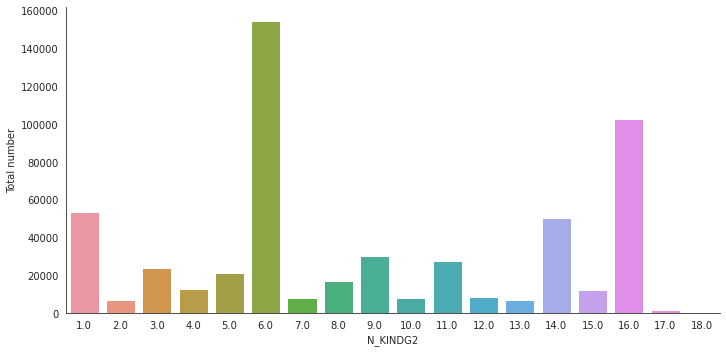

In [ ]:
with sns.axes_style('white'):
    g = sns.factorplot("N_KINDG2", data=df_24, aspect=2.0,kind='count')
    g.set_ylabels("Total number")

In [ ]:
df_24_n = df_24[['sex', 'age', 'N_KINDG1', 'N_KINDG2', 'N_FNAME3', 'N_FCODE3', 'NF_INTK', 'NF_INTK3', 
                 'NF_EN' , 'NF_WATER' , 'NF_PROT' , 'NF_FAT' , 'NF_SFA', 'NF_MUFA', 'NF_PUFA', 'NF_N3', 
                 'NF_N6', 'NF_10_0', 'NF_12_0' ,'NF_14_0' , 'NF_16_0', 'NF_18_0' ,'NF_20_0' , 'NF_22_0', 
                 'NF_24_0' ,'NF_14_1' ,'NF_16_1', 'NF_18_1' ,'NF_20_1' ,'NF_22_1', 'NF_24_1' ,'NF_18_2N6' ,
                 'NF_18_3N3', 'NF_18_3N6', 'NF_18_4', 'NF_20_2' ,'NF_20_3N6' ,'NF_20_4N6', 'NF_20_5N3' ,
                 'NF_22_2' ,'NF_22_5', 'NF_22_6N3' ,'NF_CHOL', 'NF_CHO', 'NF_TDF', 'NF_SUGAR', 'NF_CA' ,
                 'NF_PHOS' ,'NF_FE', 'NF_NA' ,'NF_K', 'NF_VA', 'NF_VA_RAE', 'NF_CAROT', 'NF_RETIN' ,
                 'NF_B1' ,'NF_B2', 'NF_NIAC', 'NF_VITC']]

In [ ]:
alls=['1']
print(df_24[df_24['N_KINDG2'].isin(alls)])

In [ ]:
alls=['11', '12']

prot= df_24[df_24['N_KINDG2'].isin(alls)]
protein_rich= prot.sort_values(by='NF_PROT', ascending= False)
top_20=protein_rich.head(100)
fig = px.bar(top_20, x='N_DNAME', y='NF_PROT', color = 'NF_PROT', title=' Top 10 protein rich foods')
fig.show()

In [ ]:
df_24['N_DNAME'].get_values().count()

In [ ]:
cals= df_24.sort_values(by='NF_EN', ascending= False)
top_20_cals=cals.head(20)
fig = px.bar(top_20, x='N_FNAME3', y='NF_EN' , color='NF_EN', title=' Top 10 calorie rich foods')
fig.show()

In [ ]:
drinks= df_24[df_24['N_KINDG2'].isin(['1','2'])]
drinks_top=drinks.sort_values(by='NF_CA', ascending= False)
drinks_top=drinks_top.head(10)

fig = go.Figure(go.Funnelarea(values=drinks_top['NF_CA'].values, text=drinks_top['N_FNAME3'],
                              title = { "text": "Desserts with high calorie percentages"},
               marker = {"colors": ["deepskyblue", "lightsalmon", "tan", "teal", "silver","deepskyblue", "lightsalmon", "tan", "teal", "silver"],
                "line": {"color": ["wheat", "wheat", "blue", "wheat", "wheat","wheat", "wheat", "blue", "wheat", "wheat"]}}))



fig.show()

In [ ]:
 from sklearn.cluster import AgglomerativeClustering
hc = AgglomerativeClustering(n_clusters = 5, affinity = 'euclidean', linkage = 'ward')
y_hc = hc.fit_predict(df_24_n)

ValueError: ignored

In [ ]:
from matplotlib import font_manager
for i in font_manager.fontManager.ttflist:
    if 'Nanum' in i.name:
        print(i.name, i.fname)

In [ ]:
with sns.axes_style('white'):
    g = sns.factorplot("N_DNAME", data=df_24, aspect=2.0,kind='count')
    g.set_ylabels("Total number")

In [ ]:
#--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [ ]:
elif (((work_high_day >= 3) | (leisure_high_day >= 3) | (work_moderate_day >= 5) | (leisure_moderate_day >= 5) | (transporation_day >= 5) | (walk_day >= 5)) & 
       ((work_high_total_min >= 20) | (leisure_high_total_min >= 20) | (work_moderate_total_min >= 30) | (leisure_moderate_total_min >= 30) | (transporation_total_min >= 30) | 
       (walk_total_min >= 30) | (met_total_walk_min >= 600) | (work_high_total_min + leisure_high_total_min >= 20) | (work_moderate_total_min + leisure_moderate_total_min >= 30))):

          return 2
      elif ((((work_high_day >=3) & (leisure_high_day >= 3)) & (met_total_vigorous_min >= 1500)) | 
            ((walk_day == 7) & (met_total_walk_min >= 3000)) | 
            ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500)):
          return 3

def calculate_activity(series):
    work_high_day = series["BE3_72"] 
    work_high_hour = series["BE3_73"]
    work_high_min = series["BE3_74"]

    work_moderate_day = series["BE3_82"]
    work_moderate_hour = series["BE3_83"]
    work_moderate_min = series["BE3_84"]

    transporation_day = series["BE3_92"]
    transporation_hour = series["BE3_93"]
    transporation_min = series["BE3_94"]

    leisure_high_day = series["BE3_76"]
    leisure_high_hour = series["BE3_77"]
    leisure_high_min = series["BE3_78"]

    leisure_moderate_day = series["BE3_86"]
    leisure_moderate_hour = series["BE3_87"]
    leisure_moderate_min = series["BE3_88"]

    sit_hour = series["BE8_1"]
    sit_min = series["BE8_2"]

    walk_day = series["BE3_31"]
    walk_hour = series["BE3_32"]
    walk_min = series["BE3_33"]

    if ((work_high_day < 8) | (work_moderate_day < 8) | 
        (transporation_hour < 8) | (leisure_high_day < 8) | 
        (leisure_moderate_day < 8) | (walk_day < 8)):
      work_high_total_min = (work_high_hour*60 + work_high_min)
      work_moderate_total_min = (work_moderate_hour*60 + work_moderate_min)
      transporation_total_min = (transporation_hour*60 + transporation_min)
      leisure_high_total_min = (leisure_high_hour*60 + leisure_high_min)
      leisure_moderate_total_min = (leisure_moderate_hour*60 + leisure_moderate_min)
      sit_total_min = (sit_hour*60 + sit_min)
      walk_total_min = (walk_hour*60 + walk_min)

      met_total_walk_min = (walk_total_min*walk_day)
      met_total_vigorous_min = ((work_high_total_min*work_high_day) + (leisure_high_total_min*leisure_high_day))
      met_total_moderate_min = ((work_moderate_total_min*work_moderate_day) + (leisure_moderate_total_min*leisure_moderate_day))

      total_physical_activity = ((work_high_total_min*work_high_day) + (work_moderate_total_min*work_moderate_day) +
                      (leisure_high_total_min*leisure_high_day) + (leisure_moderate_total_min*leisure_moderate_day) +
                      (transporation_total_min*transporation_day) + (met_total_walk_min))

      if ((work_high_total_min < 11) & (work_moderate_total_min < 11) & (transporation_total_min < 11) & 
            (leisure_high_total_min < 11) & (leisure_moderate_total_min < 11) & (work_high_total_min < 11)):
          return 1
      elif ((((work_high_day >= 3) & (work_high_total_min >= 20)) | ((leisure_high_day >= 3) & (leisure_high_total_min >= 20)))  | 
          (((work_moderate_day >= 5) & (work_moderate_total_min >= 30)) | ((leisure_moderate_day >= 5) & (leisure_moderate_total_min >= 30))) | 
          (((transporation_day >= 5) & (transporation_total_min >= 30)) | ((walk_day >= 5) & (walk_total_min >= 30))) | 
          ((walk_day >= 5) & (met_total_walk_min >= 600)) | 
          ((work_high_total_min + leisure_high_total_min >= 20) | (work_moderate_total_min + leisure_moderate_total_min >= 30))):
          return 2
      elif ((((work_high_day >=3) & (leisure_high_day >= 3)) & (met_total_vigorous_min >= 1500)) | 
            ((walk_day == 7) & (met_total_walk_min >= 3000)) | 
            ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500)):
          return 3
    else:
      return 0

      if (((work_high_day >=3) & (leisure_high_day >= 3)) | (walk_day == 7))):
        if (met_total_vigorous_min >= 1500):
          return 3
        elif (met_total_walk_min >= 3000):
          return 3
        elif ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500)):
          return 3
      elif ((work_high_day >= 3) | (leisure_high_day >= 3) | (work_moderate_day >= 5) | (leisure_moderate_day >= 5) | (transporation_day >= 5) | (walk_day >= 6)):
        if (work_high_total_min >= 20):
          return 2
        elif (leisure_high_total_min >= 20):
          return 2
        elif (work_moderate_total_min >= 30):
          return 2
        elif (leisure_moderate_total_min >= 30):
          return 2
        elif (transporation_total_min >= 30):
          return 2
        elif (walk_total_min >= 30):
          return 2
        elif (met_total_walk_min >= 600):
          return 2
        elif (work_high_total_min + leisure_high_total_min >= 20):
          return 2
        elif (work_moderate_total_min + leisure_moderate_total_min >= 30):
          return 2
      else:
        return 1

    if (((work_high_day >=3) & (leisure_high_day >= 3)) | (walk_day == 8)):
        if ((met_total_vigorous_min >= 1500) | (met_total_walk_min >= 3000) | ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500)):
          return 300000
      elif ((work_high_day >= 3) | (leisure_high_day >= 3) | (work_moderate_day >= 5) | (leisure_moderate_day >= 5) | (transporation_day >= 5) | (walk_day >= 5)):
        if ((work_high_total_min >= 20) | (leisure_high_total_min >= 20) | (work_moderate_total_min >= 30) | (leisure_moderate_total_min >= 30) | (transporation_total_min >= 30) | (walk_total_min >= 30) | (met_total_walk_min >= 600) | (work_high_total_min + leisure_high_total_min >= 20) | (work_moderate_total_min+leisure_moderate_total_min >= 30)):
          return 2000
      else:
          return 1


          if (((work_high_day >=3) & (leisure_high_day >= 3)) | (walk_day == 7)):
        if (met_total_vigorous_min >= 1500):
          return 3
        elif (met_total_walk_min >= 3000):
          return 3
        elif ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500):
          return 3
        elif (work_high_total_min >= 20):
          return 2
        elif (leisure_high_total_min >= 20):
          return 2
        elif (work_high_total_min + leisure_high_total_min >= 20):
          return 2
      elif ((work_moderate_day >= 5) | (leisure_moderate_day >= 5) | (transporation_day >= 5) | (walk_day >= 6)):
        if (work_moderate_total_min >= 30):
          return 2
        elif (leisure_moderate_total_min >= 30):
          return 2
        elif (transporation_total_min >= 30):
          return 2
        elif (walk_total_min >= 30):
          return 2
        elif (met_total_walk_min >= 600):
          return 2
        elif (work_moderate_total_min + leisure_moderate_total_min >= 30):
          return 2
      else:
        return 1
    else:
      return 0

    if ((((work_high_day >=3) & (work_high_day < 8)) & ((leisure_high_day >= 3) & (leisure_high_day < 8))) | (walk_day == 8)):
          if (met_total_vigorous_min >= 1500):
            return 3
          elif (met_total_walk_min >= 3000):
            return 3
          elif ((met_total_vigorous_min + met_total_moderate_min*2) >= 1500):
            return 3
          elif (work_high_total_min >= 20):
            return 2
          elif (leisure_high_total_min >= 20):
            return 2
          elif (work_high_total_min + leisure_high_total_min >= 20):
            return 2
        elif (((work_moderate_day >= 5) & (work_moderate_day < 8)) | ((leisure_moderate_day >= 5) & (leisure_moderate_day < 8)) | ((walk_day >= 6) & (walk_day < 9))):
          if (work_moderate_total_min >= 30):
            return 2
          elif (leisure_moderate_total_min >= 30):
            return 2
          elif (walk_total_min >= 30):
            return 2
          elif (met_total_walk_min >= 600):
            return 2
          elif (work_moderate_total_min + leisure_moderate_total_min >= 30):
            return 2
        else:
          return 1

          if (((((work_high_day >=3) & (work_high_day < 8)) & ((leisure_high_day >= 3) & (leisure_high_day < 8))) & (met_total_vigorous_min >= 1500)) | ((walk_day == 8) & (met_total_walk_min >= 3000))):
            return 3
          elif ((((work_moderate_day >= 5) & (work_moderate_day < 8)) & (work_moderate_total_min >= 30)) | 
                (((leisure_moderate_day >= 5) & (leisure_moderate_day < 8)) & (leisure_moderate_total_min >= 30)) | 
                (((work_high_day >=3) & (work_high_day < 8)) & (work_high_total_min >= 20)) | 
                (((leisure_moderate_day >= 5) & (leisure_moderate_day < 8)) & (leisure_high_total_min >= 20)) | 
                (((walk_day >= 6) & (walk_day < 9)) & (met_total_walk_min >= 600))):
            return 2
          else:
            return 1